# ACTION First Level Model

Author: Olaf Borghi olafborghi@gmail.com

## Prepare Setup

### Define fixed parameters, load libraries/modules

**Load modules**

In [1]:
# Import necessary packages and modules
%matplotlib inline
# libraries
import os
import numpy as np
import nibabel as nib
import pandas as pd
import nilearn as nl
from matplotlib import pyplot as plt
# specific modules
from nipype import Node, Workflow
from nipype.interfaces import fsl
from nilearn.glm.first_level import FirstLevelModel
from nilearn import plotting, datasets, image
from nilearn.datasets import load_mni152_template
from pathlib import Path
from pprint import pprint
from glob import glob

/usr/local/lib/python3.8/dist-packages/nilearn/glm/__init__.py:55: FutureWarning: The nilearn.glm module is experimental. It may change in any future release of Nilearn.
  warn('The nilearn.glm module is experimental. '


**Set fixed parameters**

In [2]:
# fixed folders
basedir = Path("/home/olafb99/mnt/p/userdata/olafb99/shared/03_AON_ACTION")
outputdir = Path(basedir / "derivatives")
datadir = Path(basedir / "01_data")

# first level output dir
if not os.path.exists(outputdir / "first_level"):
    os.makedirs(outputdir / "first_level")
first_level_dir = outputdir / "first_level"

if not os.path.exists(first_level_dir / "action-task"):
    os.makedirs(first_level_dir / "action-task")
action_first_level_dir = first_level_dir / "action-task"

**Import functions**

In [3]:
# I defined a number of functions that help me to import the data files from all subjects in a python script
import flm_helper_functions as flm_helpers
# let's look at the documentation of one of the functions
?flm_helpers.MyMRIImages

Signature: flm_helpers.MyMRIImages(paths)
Docstring:
Returns a dictionary with the functional or anatomical MRI images of each subject
loaded as a nib.img
Inputs: A list of paths to the functional/anatomical images, ordered by subject number
File:      ~/mnt/p/userdata/olafb99/shared/03_AON_ACTION/02_scripts/flm_helper_functions.py
Type:      function


### Load the warped anatomical and the preprocessed functional images

In [4]:
# store the paths of the warped anatomical images of all subjects in a list and load them using the function
anat_paths = sorted(glob(f"{outputdir}/*/action.feat/reg/highres2standard.nii.gz"))
anat_dict = flm_helpers.MyMRIImages(anat_paths)

# store the paths of the preprocessed functional image files of all subjects of action in a list and load them using the function
action_paths = sorted(glob(f"{outputdir}/*/action.feat/preprocessed_func_data_MNI.nii.gz"))
action_dict = flm_helpers.MyMRIImages(action_paths)

# load the MNI template
template = load_mni152_template(resolution=1)

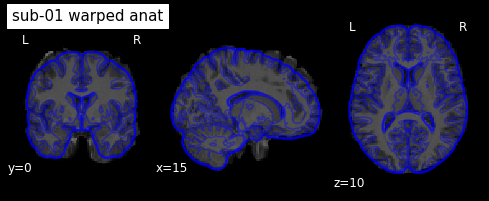

In [5]:
# sanity check - plot the warped anat a sbj
sbj = "sub-01"

anat_img= plotting.plot_anat(anat_dict.get(sbj), title = f"{sbj} warped anat", 
                   draw_cross = False, black_bg = True, cut_coords = (15, 0, 10))
anat_img.add_contours(template, filled=False, alpha=0.4, colors="b")

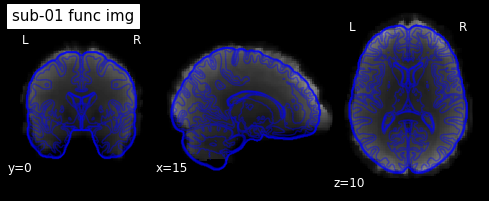

In [6]:
# sanity check - plot the preprocessed func file of AON of sub-01
sbj = "sub-01"

func_img_mean = image.mean_img(action_dict.get(sbj))

func_img = plotting.plot_anat(func_img_mean, title = f"{sbj} func img", 
                   draw_cross = False, black_bg = True, cut_coords = (15, 0, 10))

func_img.add_contours(template, filled=False, alpha=0.4, colors="b")

### Load the realignment parameters and framewise displacement confounds

In [7]:
# store paths of action realignment parameters in a list and use the function to load the motion parameters of action
action_pars_path = sorted(glob(f"{outputdir}/*/action.feat/mc/prefiltered_func_data_mcf.par"))
action_fd_path = sorted(glob(f"{outputdir}/*/action.feat/motion_assess/confound.txt"))
action_pars_dict = flm_helpers.MyMotionParameters(action_pars_path, action_fd_path)

Percentage of volums with fd > 0.9 of subject 1 =  FD    0.0
dtype: float64
Percentage of volums with fd > 0.9 of subject 2 =  FD    10.958904
dtype: float64
Percentage of volums with fd > 0.9 of subject 3 =  FD    2.293578
dtype: float64
Percentage of volums with fd > 0.9 of subject 4 =  FD    0.0
dtype: float64
Percentage of volums with fd > 0.9 of subject 5 =  FD    0.0
dtype: float64
Percentage of volums with fd > 0.9 of subject 6 =  FD    0.0
dtype: float64
Percentage of volums with fd > 0.9 of subject 7 =  FD    0.0
dtype: float64
Percentage of volums with fd > 0.9 of subject 8 =  FD    0.0
dtype: float64
Percentage of volums with fd > 0.9 of subject 9 =  FD    0.0
dtype: float64
Percentage of volums with fd > 0.9 of subject 10 =  FD    0.913242
dtype: float64
Percentage of volums with fd > 0.9 of subject 11 =  FD    0.0
dtype: float64
Percentage of volums with fd > 0.9 of subject 12 =  FD    0.0
dtype: float64
Percentage of volums with fd > 0.9 of subject 13 =  FD    0.909091
dt

### Load the events.tsv files

In [8]:
# load paths of action event files in a list and use the function to store them in a dict
action_events_path = sorted(glob(f"{datadir}/*/func/*_task-action_events.tsv"))
action_events_dict = flm_helpers.MyEventFiles(action_events_path)

In [9]:
# sanity check - inspect events.tsv file of a subject of action
sbj = "sub-01"
events_action = action_events_dict.get(sbj)
# display shape of events file
print(events_action.shape)
# display 5 first and last values of each column
events_action.head(5)

(12, 12)


,onset,duration,offset,condition,trial_type,participant_id,date,session,attempt,dur_fixation,task_duration,pic_name
0,10.001267,10.001324,20.002590,1,Hand motion,sub-01,2020-09-24-13-22-04,1,1,10,260.409657,hand_600x600.png
1,30.028533,10.000255,40.028787,1,Hand motion,sub-01,2020-09-24-13-22-04,1,1,10,260.409657,hand_600x600.png
2,50.060787,10.001550,60.062337,2,Mouth motion,sub-01,2020-09-24-13-22-04,1,1,10,260.409657,mouth_600x600.png
3,70.094950,10.000961,80.095911,2,Mouth motion,sub-01,2020-09-24-13-22-04,1,1,10,260.409657,mouth_600x600.png
4,90.127574,10.000279,100.127853,1,Hand motion,sub-01,2020-09-24-13-22-04,1,1,10,260.409657,hand_600x600.png


### First level model of ACTION

Now that we have our first level model for the AON task, we can go on and do the same for the ACTION task. 

Again, let's first work on the first level model of one subject (sub-01).

In [10]:
sbj = "sub-01"

# I used the TR from the experiment, and for all other params I used the default values
action_first_level = FirstLevelModel(t_r=1.2,
                              hrf_model="spm",
                              drift_model="cosine",
                              slice_time_ref=0, # slice time correction was already applied
                              high_pass=1/128, 
                              minimize_memory = False, # for voxelwise attributes like R-Squared
                              verbose=True) 

In [11]:
# fit ACTION first level model of sub-01
action_first_level_fit = action_first_level.fit(action_dict.get(sbj), 
                                                events = action_events_dict.get(sbj),
                                                confounds = action_pars_dict.get(sbj))

Computing run 1 out of 1 runs (go take a coffee, a big one)
/usr/local/lib/python3.8/dist-packages/nilearn/glm/first_level/experimental_paradigm.py:89: UserWarning: Unexpected column `dur_fixation` in events data will be ignored.
  warnings.warn(("Unexpected column `{}` in events "
/usr/local/lib/python3.8/dist-packages/nilearn/glm/first_level/experimental_paradigm.py:89: UserWarning: Unexpected column `condition` in events data will be ignored.
  warnings.warn(("Unexpected column `{}` in events "
/usr/local/lib/python3.8/dist-packages/nilearn/glm/first_level/experimental_paradigm.py:89: UserWarning: Unexpected column `offset` in events data will be ignored.
  warnings.warn(("Unexpected column `{}` in events "
/usr/local/lib/python3.8/dist-packages/nilearn/glm/first_level/experimental_paradigm.py:89: UserWarning: Unexpected column `participant_id` in events data will be ignored.
  warnings.warn(("Unexpected column `{}` in events "
/usr/local/lib/python3.8/dist-packages/nilearn/glm/firs

(218, 14)


Text(0.5, 1.0, 'ACTION design matrix')

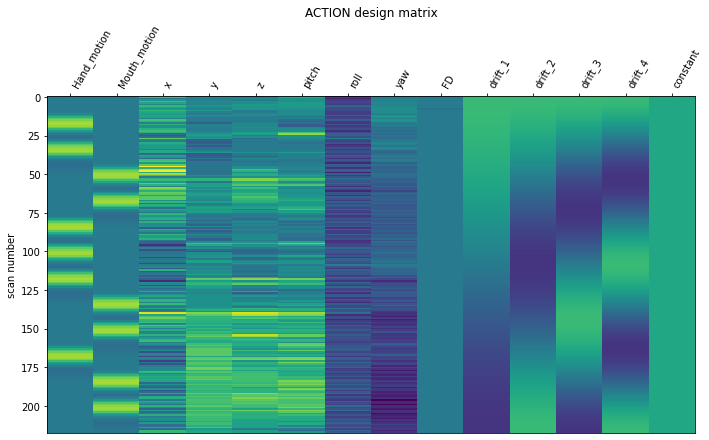

In [12]:
# we choose the first design matrix (model is implicitly ment for multiple run, we only analysed one run)
X = action_first_level_fit.design_matrices_[0]

# print the shape of the design matrix
print(np.shape(X))

# plot the design matrix
from nilearn.plotting import plot_design_matrix
fig, ax = plt.subplots(figsize=(10, 6), nrows=1, ncols=1)
plot_design_matrix(X, ax=ax)
ax.set_title('ACTION design matrix', fontsize=12)

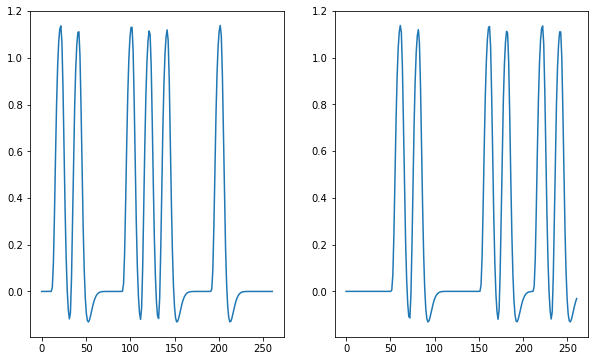

In [13]:
# plot an exemplary HRF
fig, axes = plt.subplots(figsize=(10, 6), nrows=1, ncols=2)
axes[0].plot(X["Hand_motion"])
axes[1].plot(X["Mouth_motion"])

In [14]:
# set n_columns for the pad_contrast function
n_columns = action_first_level_fit.design_matrices_[0].shape[1]

# setup contrast dictonary for ACTION
contrasts = {
    "action-baseline": flm_helpers.pad_vector([1,1,], n_columns),
    "motion-baseline": flm_helpers.pad_vector([0,0,1,1,1,1,1,1,], n_columns),
    "hand-baseline": flm_helpers.pad_vector([1,], n_columns),
    "mouth-baseline": flm_helpers.pad_vector([0,1,], n_columns),
    "hand-mouth": flm_helpers.pad_vector([1,-1,], n_columns),
    "mouth-hand": flm_helpers.pad_vector([-1,1,], n_columns),
}

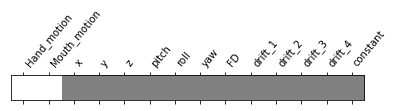

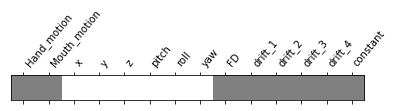

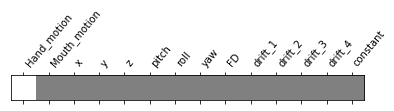

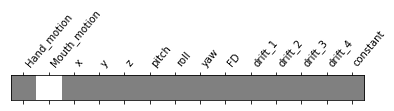

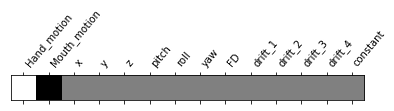

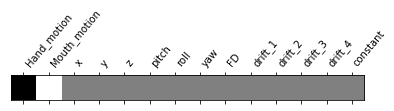

In [15]:
# plot the contrast matrix
for id, val in contrasts.items():
    plotting.plot_contrast_matrix(val, design_matrix=X)

#### Plot the ACTION results for sub-01

contrast id: action-baseline
contrast val: [1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


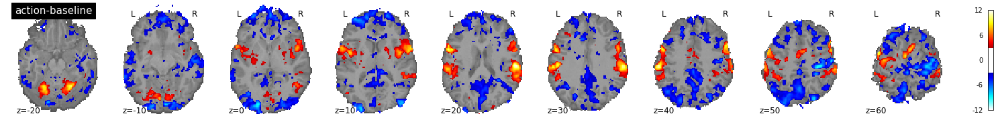

contrast id: motion-baseline
contrast val: [0. 0. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0.]


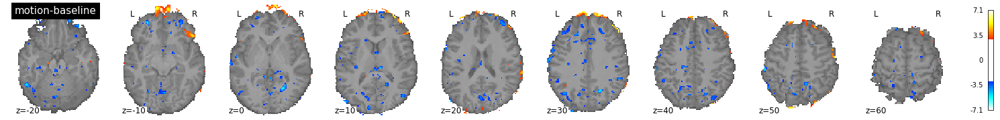

contrast id: hand-baseline
contrast val: [1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


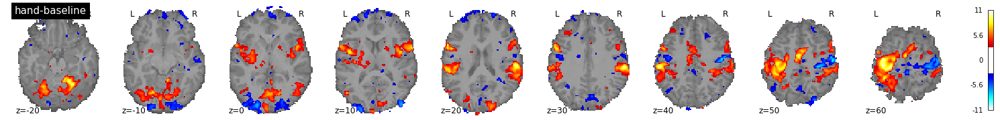

contrast id: mouth-baseline
contrast val: [0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


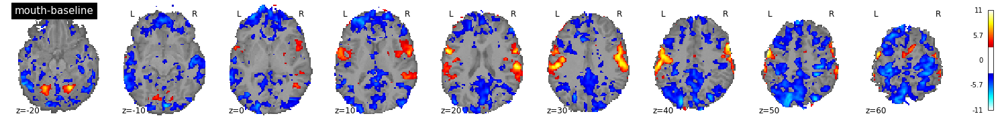

contrast id: hand-mouth
contrast val: [ 1. -1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]


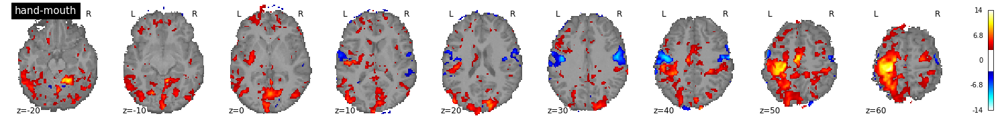

contrast id: mouth-hand
contrast val: [-1.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]


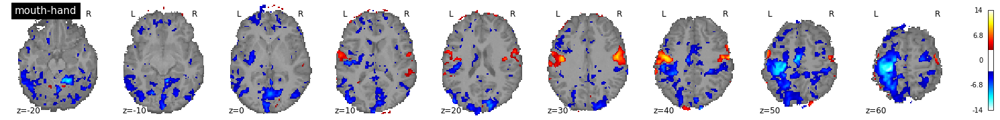

In [16]:
# plotting the contrast maps for each condition

for contrast_id, contrast_val in contrasts.items():
    print(f"contrast id: {contrast_id}")
    print(f"contrast val: {contrast_val}")
    
    # compute the contrasts
    z_map = action_first_level.compute_contrast(contrast_val, 
                                      output_type='z_score')
    # plot the contrasts 
    # the display is overlaid on the warped anatomical
    
    plotting.plot_stat_map(
        z_map, 
        threshold=3.0, 
        display_mode='z',
        bg_img=anat_dict.get(sbj),
        cut_coords=range(-20, 70, 10), 
        black_bg=False, 
        title=contrast_id,
        symmetric_cbar=True)
    plotting.show()

The first level model works!

## Using a loop to fit a first level model for all subjects

So now its time to use a for-loop to compute the first_level model for all 40 subjects for the ACTION task.

Helpful resources for this:
https://lukas-snoek.com/NI-edu/fMRI-introduction/week_7/nilearn_stats.html#creating-design-matrices

In [17]:
# create a list with all subject ids for indexing
sbj_list = [f"sub-{i:02d}" for i in range(1, 41)]
print(sbj_list)

['sub-01', 'sub-02', 'sub-03', 'sub-04', 'sub-05', 'sub-06', 'sub-07', 'sub-08', 'sub-09', 'sub-10', 'sub-11', 'sub-12', 'sub-13', 'sub-14', 'sub-15', 'sub-16', 'sub-17', 'sub-18', 'sub-19', 'sub-20', 'sub-21', 'sub-22', 'sub-23', 'sub-24', 'sub-25', 'sub-26', 'sub-27', 'sub-28', 'sub-29', 'sub-30', 'sub-31', 'sub-32', 'sub-33', 'sub-34', 'sub-35', 'sub-36', 'sub-37', 'sub-38', 'sub-39', 'sub-40']


In [18]:
action_flm_dict = {} # empty dict to store the first level models
# iterate over subjects
for idx, sbj in enumerate(sbj_list):
    # create First Level Model object
    print(f"Working on first level model of ACTION of {sbj}")
    flm = FirstLevelModel(t_r=1.2,
                              hrf_model="spm",
                              drift_model="cosine",
                              slice_time_ref=0, # slice time correction was already applied
                              high_pass=1/128, 
                              minimize_memory = False, # for voxelwise attributes like R-Squared
                              n_jobs = 1,
                              verbose=True) 
    # fit first level model
    flm = flm.fit(action_dict.get(sbj), 
                   events = action_events_dict.get(sbj),
                   confounds = action_pars_dict.get(sbj))
    action_flm_dict[f"{sbj}"] = flm
action_flm_dict

Working on first level model of ACTION of sub-01


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 15 seconds



Working on first level model of ACTION of sub-02


Computing run 1 out of 1 runs (go take a coffee, a big one)
/usr/local/lib/python3.8/dist-packages/nilearn/glm/first_level/first_level.py:64: UserWarning: Mean values of 0 observed.The data have probably been centered.Scaling might not work as expected
  warn('Mean values of 0 observed.'

Computation of 1 runs done in 14 seconds



Working on first level model of ACTION of sub-03


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 14 seconds



Working on first level model of ACTION of sub-04


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 13 seconds



Working on first level model of ACTION of sub-05


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 16 seconds



Working on first level model of ACTION of sub-06


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 15 seconds



Working on first level model of ACTION of sub-07


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 15 seconds



Working on first level model of ACTION of sub-08


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 13 seconds



Working on first level model of ACTION of sub-09


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 48 seconds



Working on first level model of ACTION of sub-10


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 64 seconds



Working on first level model of ACTION of sub-11


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 50 seconds



Working on first level model of ACTION of sub-12


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 46 seconds



Working on first level model of ACTION of sub-13


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 36 seconds



Working on first level model of ACTION of sub-14


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 31 seconds



Working on first level model of ACTION of sub-15


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 51 seconds



Working on first level model of ACTION of sub-16


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 26 seconds



Working on first level model of ACTION of sub-17


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 24 seconds



Working on first level model of ACTION of sub-18


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 46 seconds



Working on first level model of ACTION of sub-19


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 48 seconds



Working on first level model of ACTION of sub-20


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 47 seconds



Working on first level model of ACTION of sub-21


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 45 seconds



Working on first level model of ACTION of sub-22


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 34 seconds



Working on first level model of ACTION of sub-23


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 60 seconds



Working on first level model of ACTION of sub-24


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 60 seconds



Working on first level model of ACTION of sub-25


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 51 seconds



Working on first level model of ACTION of sub-26


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 37 seconds



Working on first level model of ACTION of sub-27


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 33 seconds



Working on first level model of ACTION of sub-28


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 44 seconds



Working on first level model of ACTION of sub-29


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 33 seconds



Working on first level model of ACTION of sub-30


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 50 seconds



Working on first level model of ACTION of sub-31


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 51 seconds



Working on first level model of ACTION of sub-32


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 47 seconds



Working on first level model of ACTION of sub-33


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 61 seconds



Working on first level model of ACTION of sub-34


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 16 seconds



Working on first level model of ACTION of sub-35


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 15 seconds



Working on first level model of ACTION of sub-36


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 13 seconds



Working on first level model of ACTION of sub-37


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 13 seconds



Working on first level model of ACTION of sub-38


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 13 seconds



Working on first level model of ACTION of sub-39


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 14 seconds



Working on first level model of ACTION of sub-40


Computing run 1 out of 1 runs (go take a coffee, a big one)

Computation of 1 runs done in 15 seconds



{'sub-01': FirstLevelModel(high_pass=0.0078125, hrf_model='spm', minimize_memory=False,
                 slice_time_ref=0, t_r=1.2, verbose=True),
 'sub-02': FirstLevelModel(high_pass=0.0078125, hrf_model='spm', minimize_memory=False,
                 slice_time_ref=0, t_r=1.2, verbose=True),
 'sub-03': FirstLevelModel(high_pass=0.0078125, hrf_model='spm', minimize_memory=False,
                 slice_time_ref=0, t_r=1.2, verbose=True),
 'sub-04': FirstLevelModel(high_pass=0.0078125, hrf_model='spm', minimize_memory=False,
                 slice_time_ref=0, t_r=1.2, verbose=True),
 'sub-05': FirstLevelModel(high_pass=0.0078125, hrf_model='spm', minimize_memory=False,
                 slice_time_ref=0, t_r=1.2, verbose=True),
 'sub-06': FirstLevelModel(high_pass=0.0078125, hrf_model='spm', minimize_memory=False,
                 slice_time_ref=0, t_r=1.2, verbose=True),
 'sub-07': FirstLevelModel(high_pass=0.0078125, hrf_model='spm', minimize_memory=False,
                 slice_time_re

In [19]:
# create a folder to store the design matrices

if not os.path.exists(action_first_level_dir / "design_matrices"):
    os.makedirs(action_first_level_dir / "design_matrices")

# save the design matrices 
    
for i, sbj in enumerate(sbj_list): 
    
    # storage folder
    design_matrix_dir = f"{action_first_level_dir}/design_matrices/{sbj}_action_design_matrix.png"
    
    # load design matrices
    X = action_flm_dict.get(sbj).design_matrices_[0]
    
    # create a figure and store it 
    fig, ax = plt.subplots(figsize=(10, 6), nrows=1, ncols=1)
    plot_design_matrix(X, ax=ax)
    ax.set_title('Action design matrix', fontsize=12)
    fig.suptitle(sbj)
    fig.savefig(design_matrix_dir)
    plt.close(fig)

Put all the design matrices in a html file --> makes it easier to inspect whether they are correct

In [20]:
%%bash

# put all design matrices in a html file, makes it easier to inspect them later on!
cd /home/olafb99/mnt/p/userdata/olafb99/shared/03_AON_ACTION/derivatives/first_level/action-task/design_matrices
for file in *.png; do echo "<img src=\"$file\" />" >> action_design_matrices.html; done

#### Fit the contrasts and store the z-maps

Now we are good to go to fit the contrasts and to store the z-maps of all contrasts of each subject!

 Working on subject: sub-01
  Contrast  1 out of 6: action-baseline


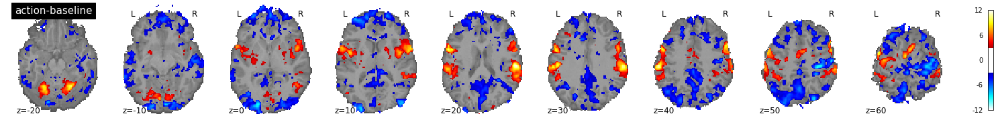

 Done working on subject: sub-01
  Contrast  2 out of 6: motion-baseline


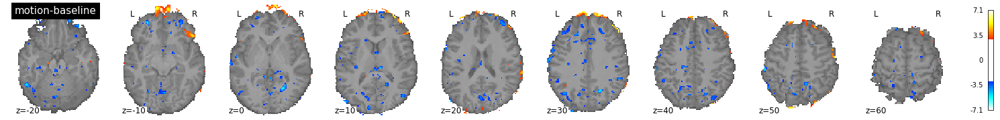

 Done working on subject: sub-01
  Contrast  3 out of 6: hand-baseline


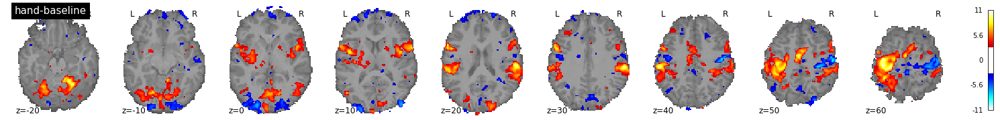

 Done working on subject: sub-01
  Contrast  4 out of 6: mouth-baseline


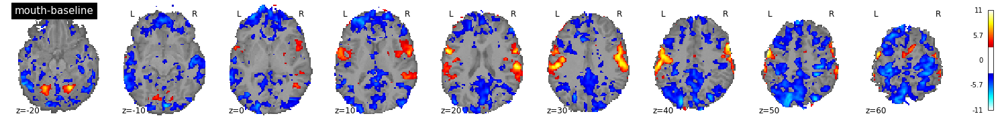

 Done working on subject: sub-01
  Contrast  5 out of 6: hand-mouth


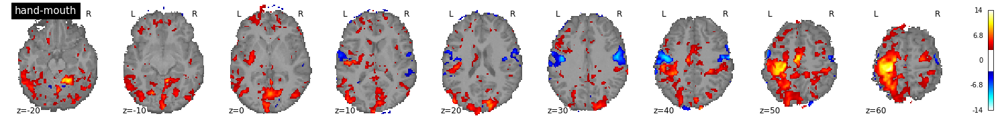

 Done working on subject: sub-01
  Contrast  6 out of 6: mouth-hand


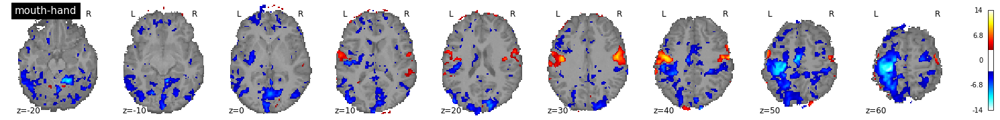

 Done working on subject: sub-01
 Working on subject: sub-02
  Contrast  1 out of 6: action-baseline


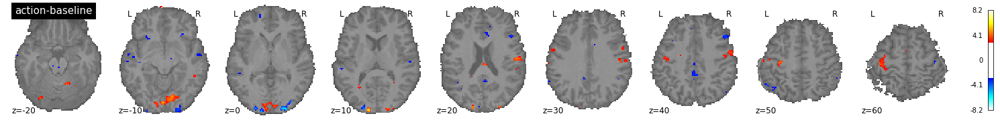

 Done working on subject: sub-02
  Contrast  2 out of 6: motion-baseline


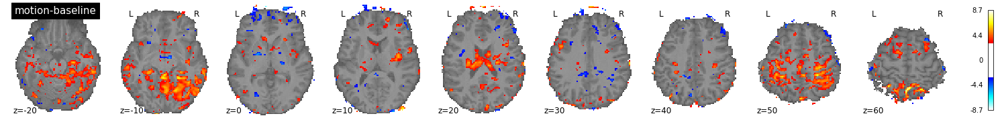

 Done working on subject: sub-02
  Contrast  3 out of 6: hand-baseline


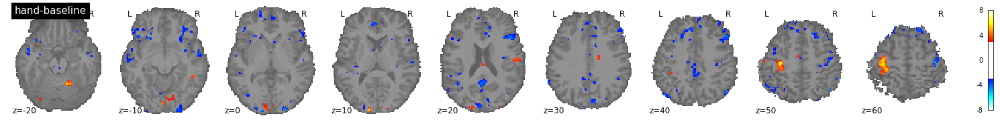

 Done working on subject: sub-02
  Contrast  4 out of 6: mouth-baseline


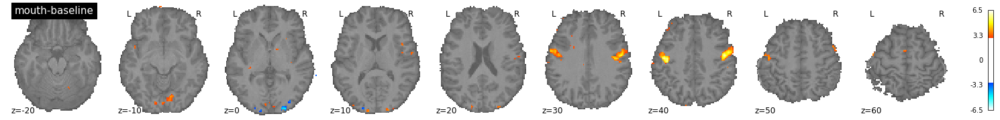

 Done working on subject: sub-02
  Contrast  5 out of 6: hand-mouth


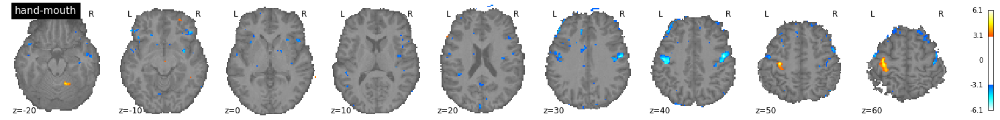

 Done working on subject: sub-02
  Contrast  6 out of 6: mouth-hand


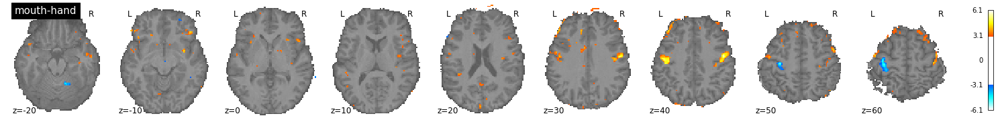

 Done working on subject: sub-02
 Working on subject: sub-03
  Contrast  1 out of 6: action-baseline


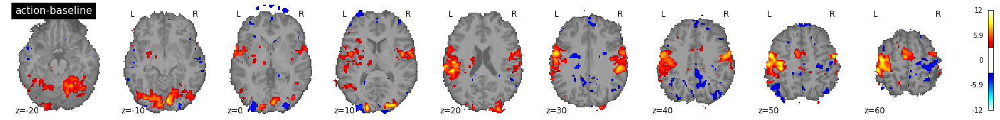

 Done working on subject: sub-03
  Contrast  2 out of 6: motion-baseline


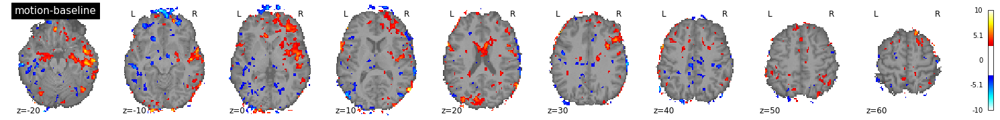

 Done working on subject: sub-03
  Contrast  3 out of 6: hand-baseline


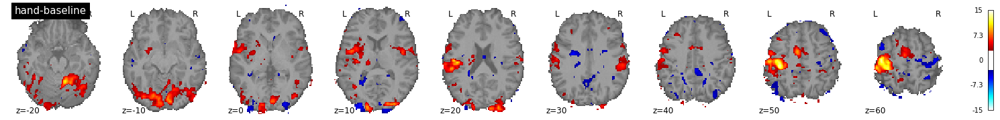

 Done working on subject: sub-03
  Contrast  4 out of 6: mouth-baseline


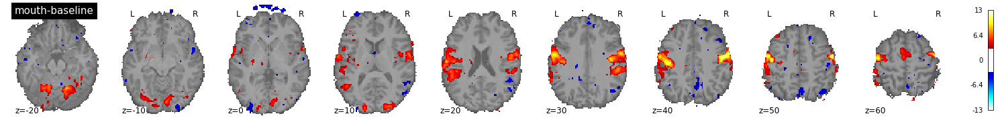

 Done working on subject: sub-03
  Contrast  5 out of 6: hand-mouth


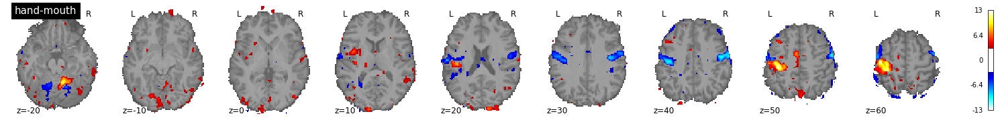

 Done working on subject: sub-03
  Contrast  6 out of 6: mouth-hand


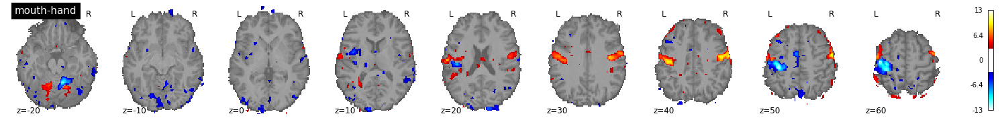

 Done working on subject: sub-03
 Working on subject: sub-04
  Contrast  1 out of 6: action-baseline


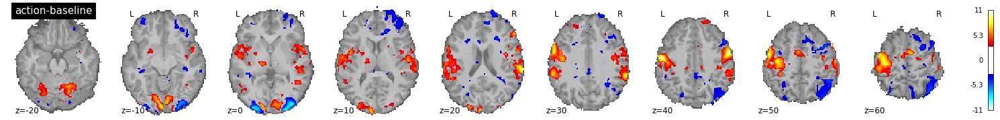

 Done working on subject: sub-04
  Contrast  2 out of 6: motion-baseline


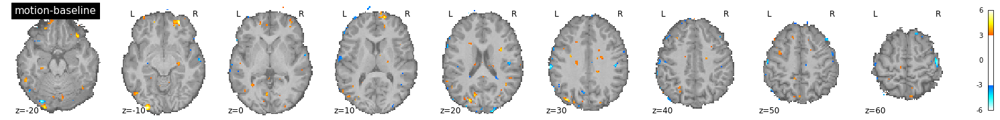

 Done working on subject: sub-04
  Contrast  3 out of 6: hand-baseline


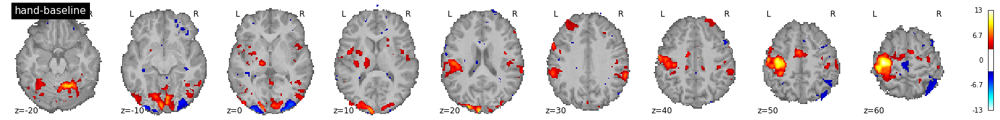

 Done working on subject: sub-04
  Contrast  4 out of 6: mouth-baseline


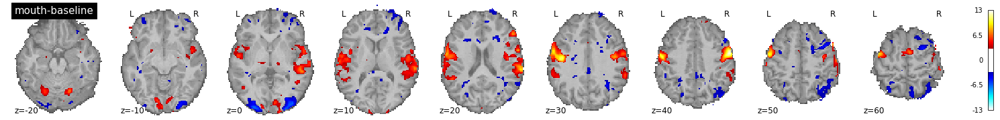

 Done working on subject: sub-04
  Contrast  5 out of 6: hand-mouth


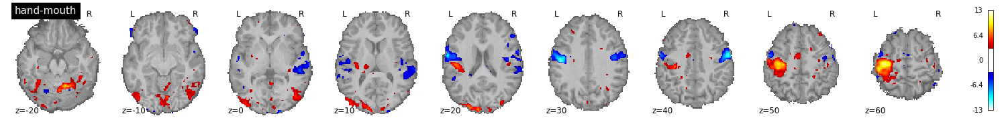

 Done working on subject: sub-04
  Contrast  6 out of 6: mouth-hand


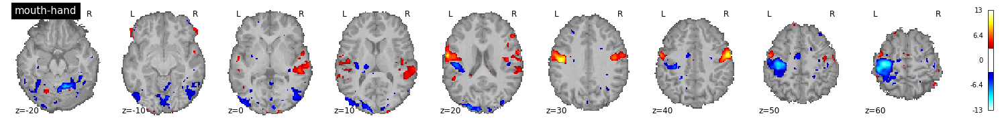

 Done working on subject: sub-04
 Working on subject: sub-05
  Contrast  1 out of 6: action-baseline


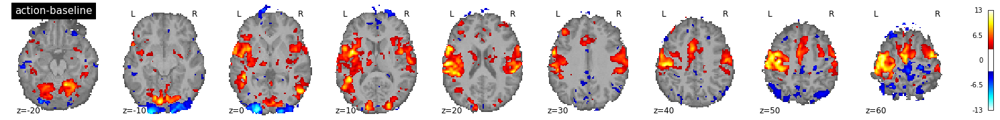

 Done working on subject: sub-05
  Contrast  2 out of 6: motion-baseline


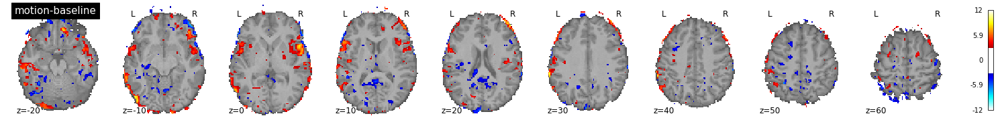

 Done working on subject: sub-05
  Contrast  3 out of 6: hand-baseline


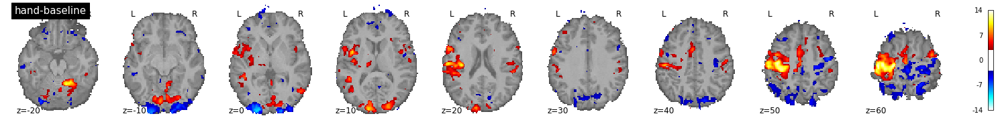

 Done working on subject: sub-05
  Contrast  4 out of 6: mouth-baseline


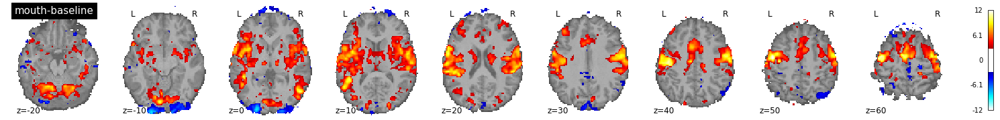

 Done working on subject: sub-05
  Contrast  5 out of 6: hand-mouth


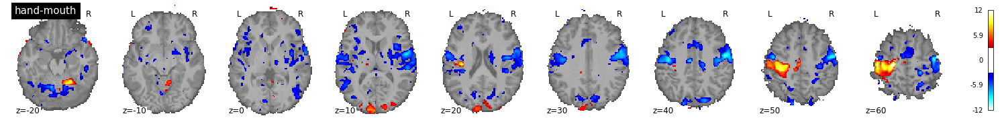

 Done working on subject: sub-05
  Contrast  6 out of 6: mouth-hand


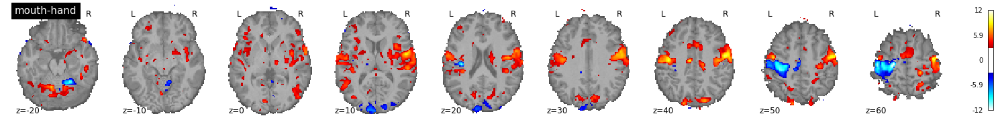

 Done working on subject: sub-05
 Working on subject: sub-06
  Contrast  1 out of 6: action-baseline


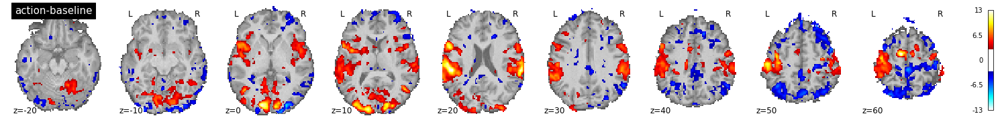

 Done working on subject: sub-06
  Contrast  2 out of 6: motion-baseline


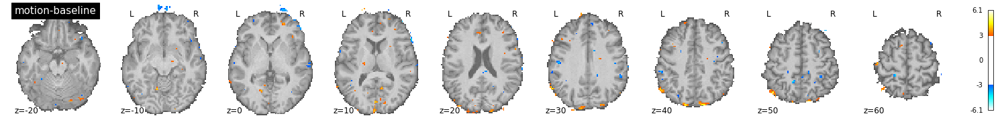

 Done working on subject: sub-06
  Contrast  3 out of 6: hand-baseline


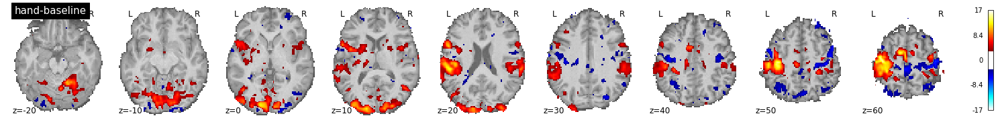

 Done working on subject: sub-06
  Contrast  4 out of 6: mouth-baseline


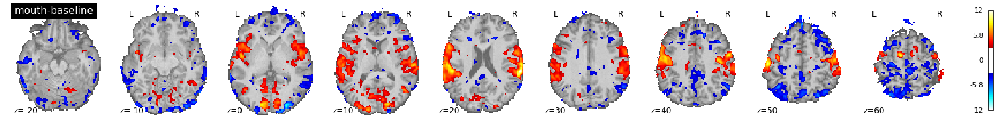

 Done working on subject: sub-06
  Contrast  5 out of 6: hand-mouth


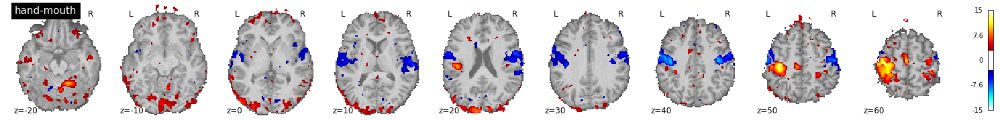

 Done working on subject: sub-06
  Contrast  6 out of 6: mouth-hand


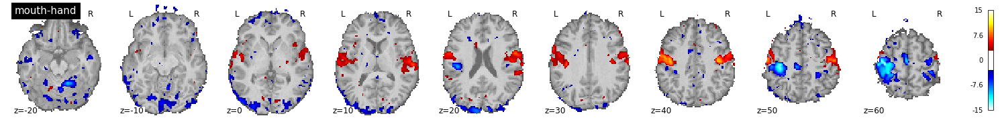

 Done working on subject: sub-06
 Working on subject: sub-07
  Contrast  1 out of 6: action-baseline


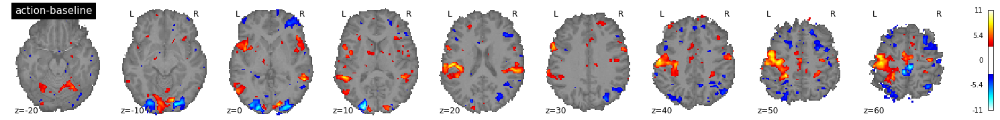

 Done working on subject: sub-07
  Contrast  2 out of 6: motion-baseline


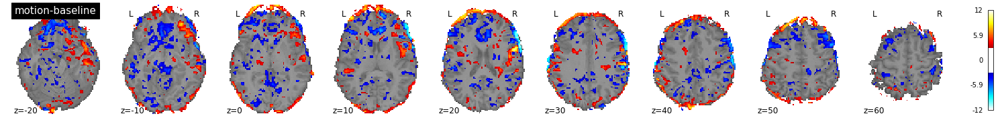

 Done working on subject: sub-07
  Contrast  3 out of 6: hand-baseline


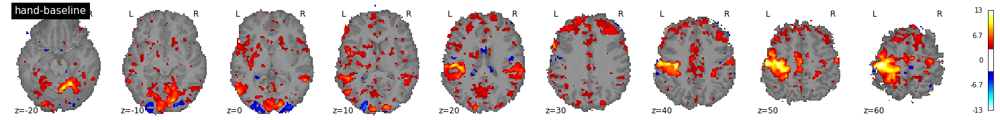

 Done working on subject: sub-07
  Contrast  4 out of 6: mouth-baseline


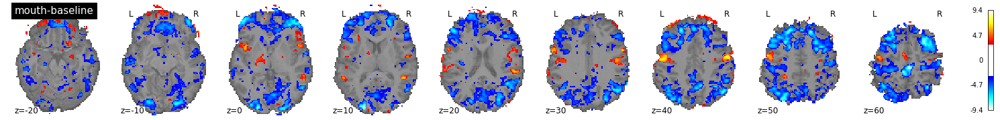

 Done working on subject: sub-07
  Contrast  5 out of 6: hand-mouth


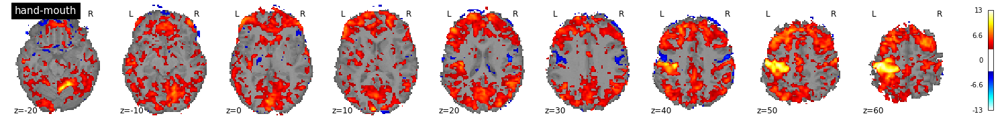

 Done working on subject: sub-07
  Contrast  6 out of 6: mouth-hand


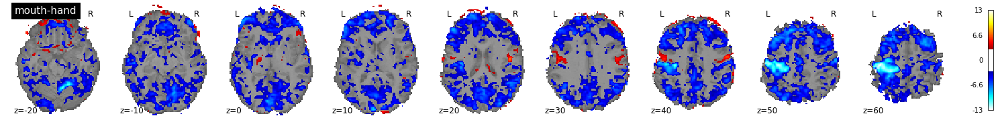

 Done working on subject: sub-07
 Working on subject: sub-08
  Contrast  1 out of 6: action-baseline


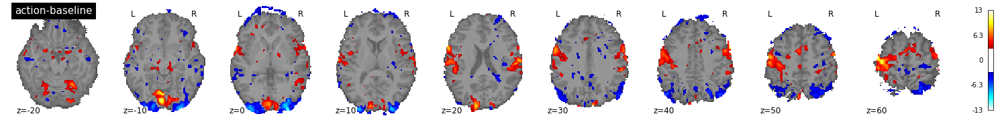

 Done working on subject: sub-08
  Contrast  2 out of 6: motion-baseline


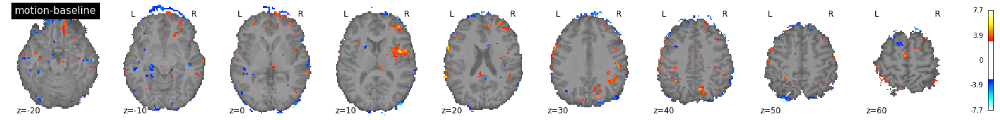

 Done working on subject: sub-08
  Contrast  3 out of 6: hand-baseline


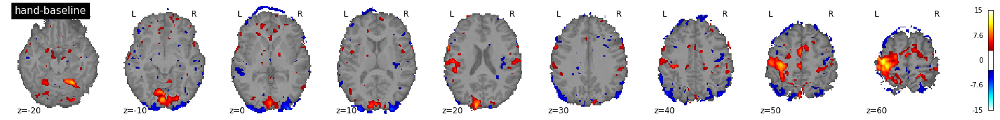

 Done working on subject: sub-08
  Contrast  4 out of 6: mouth-baseline


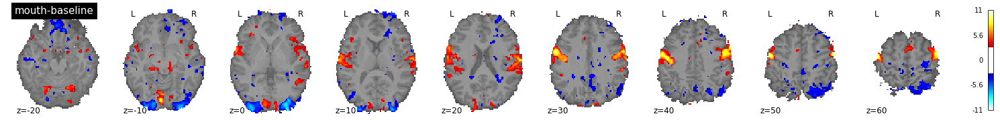

 Done working on subject: sub-08
  Contrast  5 out of 6: hand-mouth


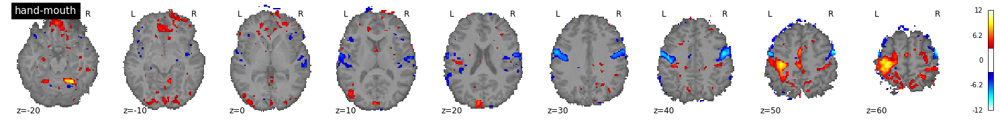

 Done working on subject: sub-08
  Contrast  6 out of 6: mouth-hand


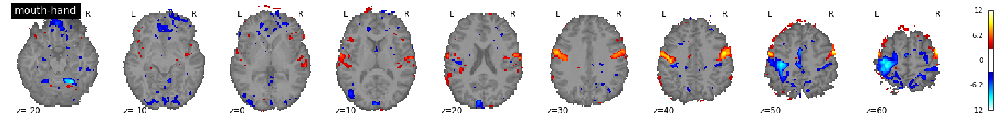

 Done working on subject: sub-08
 Working on subject: sub-09
  Contrast  1 out of 6: action-baseline


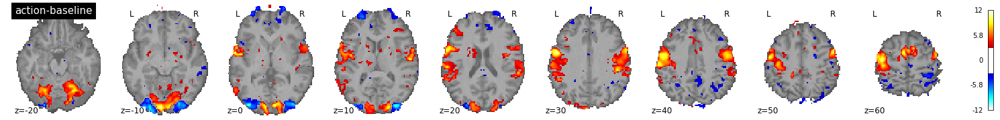

 Done working on subject: sub-09
  Contrast  2 out of 6: motion-baseline


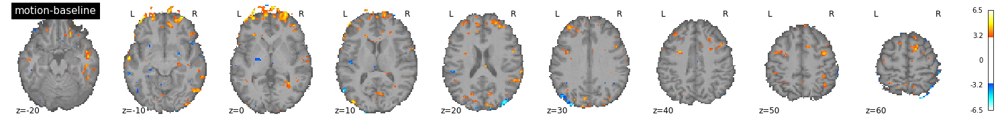

 Done working on subject: sub-09
  Contrast  3 out of 6: hand-baseline


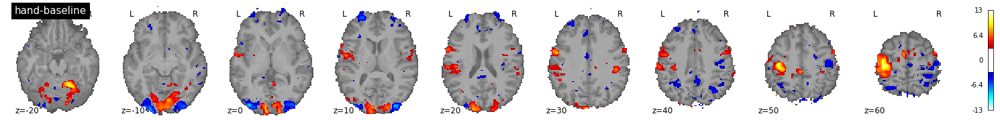

 Done working on subject: sub-09
  Contrast  4 out of 6: mouth-baseline


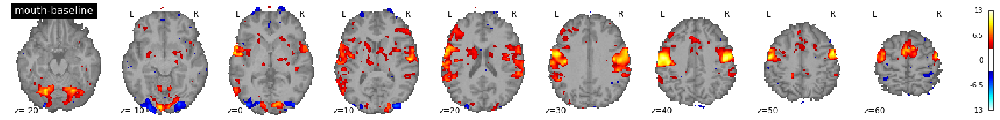

 Done working on subject: sub-09
  Contrast  5 out of 6: hand-mouth


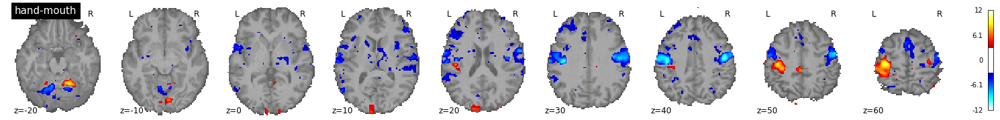

 Done working on subject: sub-09
  Contrast  6 out of 6: mouth-hand


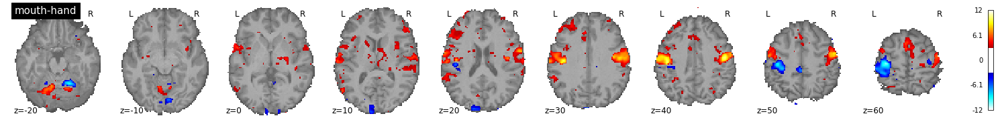

 Done working on subject: sub-09
 Working on subject: sub-10
  Contrast  1 out of 6: action-baseline


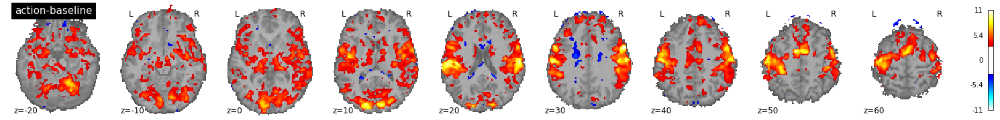

 Done working on subject: sub-10
  Contrast  2 out of 6: motion-baseline


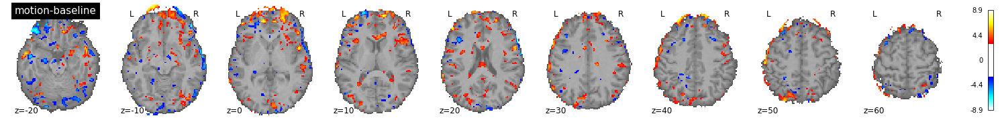

 Done working on subject: sub-10
  Contrast  3 out of 6: hand-baseline


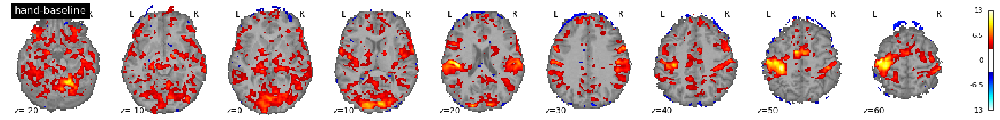

 Done working on subject: sub-10
  Contrast  4 out of 6: mouth-baseline


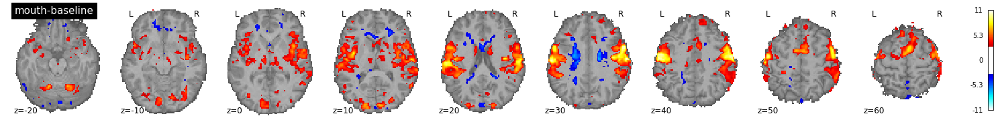

 Done working on subject: sub-10
  Contrast  5 out of 6: hand-mouth


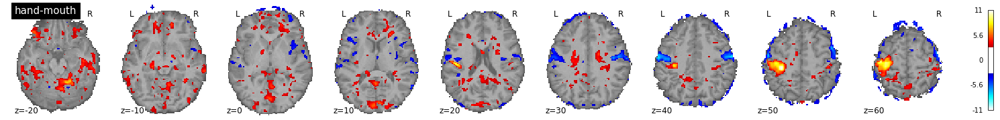

 Done working on subject: sub-10
  Contrast  6 out of 6: mouth-hand


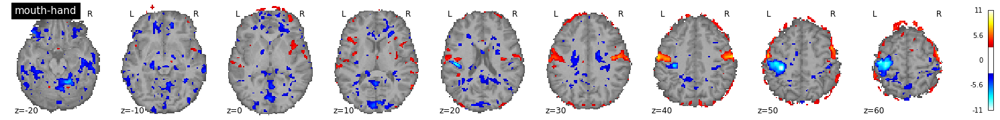

 Done working on subject: sub-10
 Working on subject: sub-11
  Contrast  1 out of 6: action-baseline


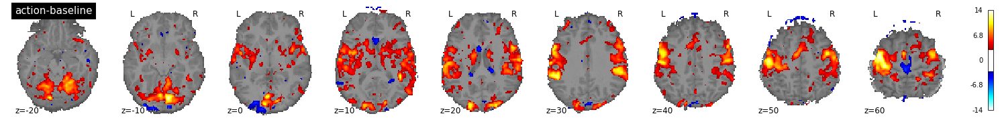

 Done working on subject: sub-11
  Contrast  2 out of 6: motion-baseline


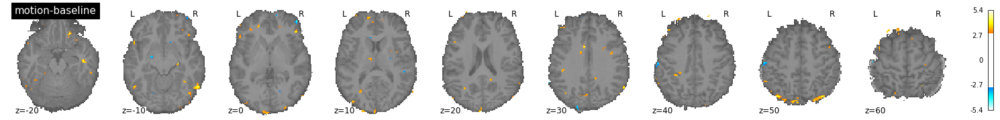

 Done working on subject: sub-11
  Contrast  3 out of 6: hand-baseline


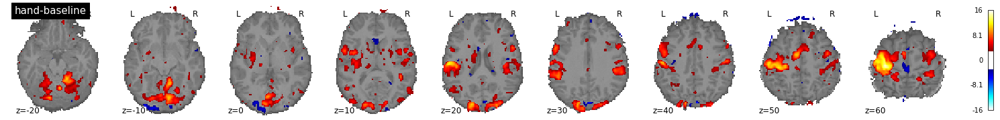

 Done working on subject: sub-11
  Contrast  4 out of 6: mouth-baseline


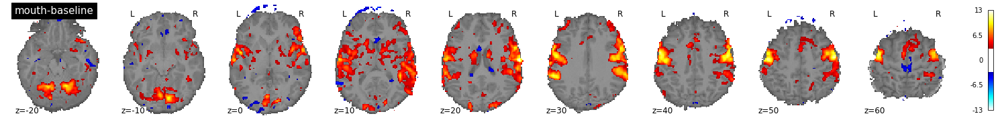

 Done working on subject: sub-11
  Contrast  5 out of 6: hand-mouth


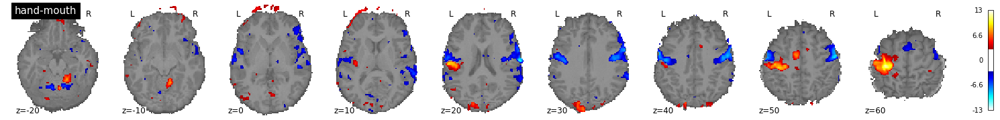

 Done working on subject: sub-11
  Contrast  6 out of 6: mouth-hand


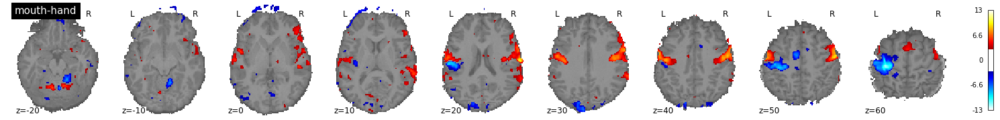

 Done working on subject: sub-11
 Working on subject: sub-12
  Contrast  1 out of 6: action-baseline


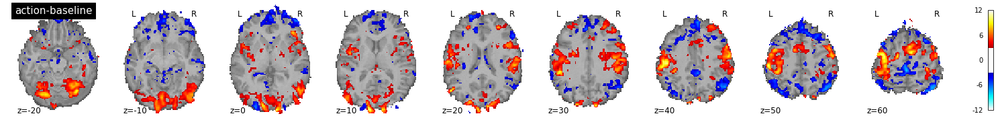

 Done working on subject: sub-12
  Contrast  2 out of 6: motion-baseline


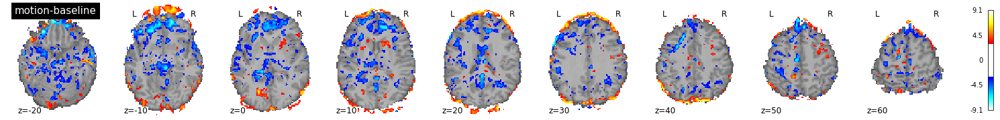

 Done working on subject: sub-12
  Contrast  3 out of 6: hand-baseline


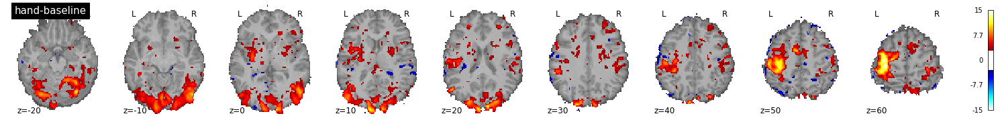

 Done working on subject: sub-12
  Contrast  4 out of 6: mouth-baseline


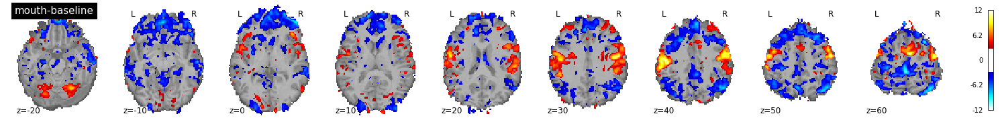

 Done working on subject: sub-12
  Contrast  5 out of 6: hand-mouth


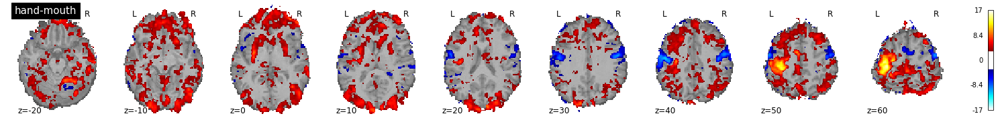

 Done working on subject: sub-12
  Contrast  6 out of 6: mouth-hand


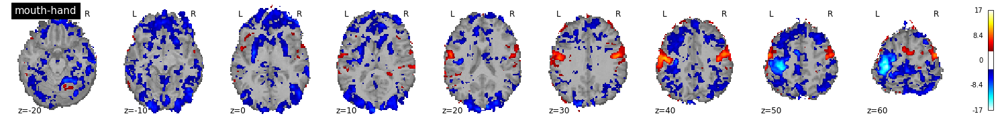

 Done working on subject: sub-12
 Working on subject: sub-13
  Contrast  1 out of 6: action-baseline


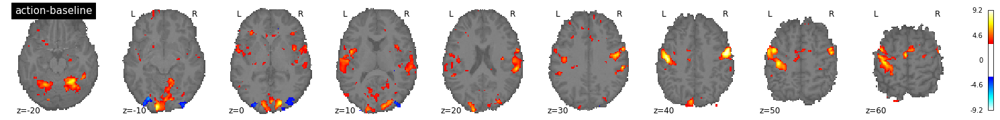

 Done working on subject: sub-13
  Contrast  2 out of 6: motion-baseline


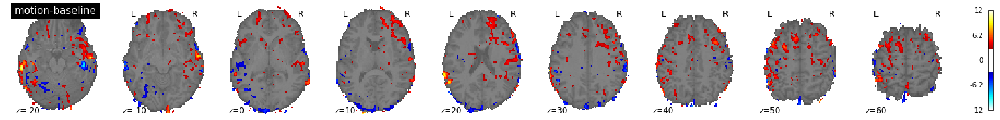

 Done working on subject: sub-13
  Contrast  3 out of 6: hand-baseline


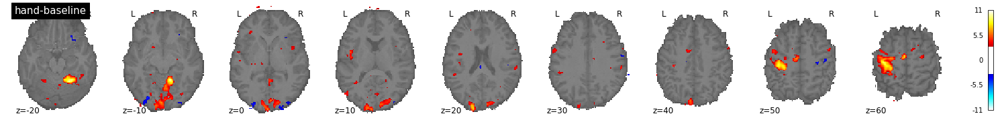

 Done working on subject: sub-13
  Contrast  4 out of 6: mouth-baseline


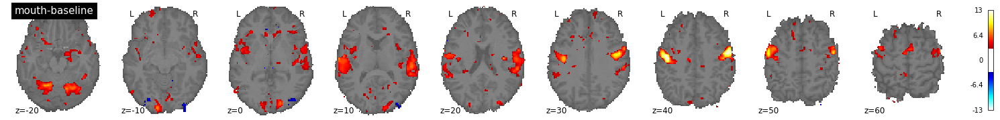

 Done working on subject: sub-13
  Contrast  5 out of 6: hand-mouth


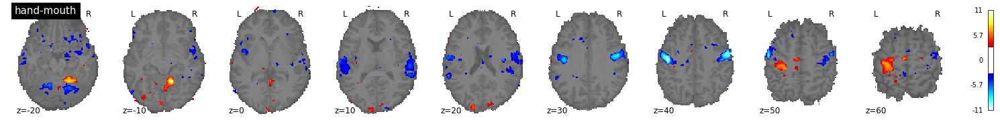

 Done working on subject: sub-13
  Contrast  6 out of 6: mouth-hand


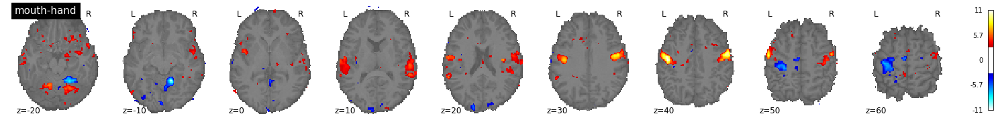

 Done working on subject: sub-13
 Working on subject: sub-14
  Contrast  1 out of 6: action-baseline


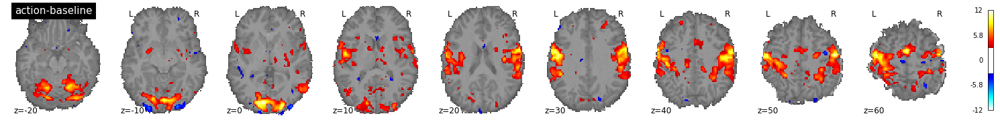

 Done working on subject: sub-14
  Contrast  2 out of 6: motion-baseline


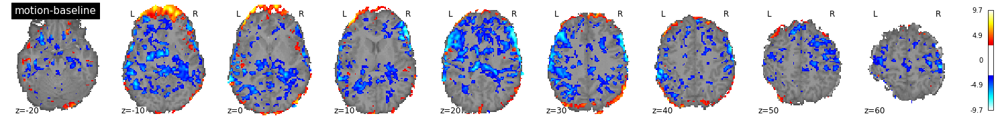

 Done working on subject: sub-14
  Contrast  3 out of 6: hand-baseline


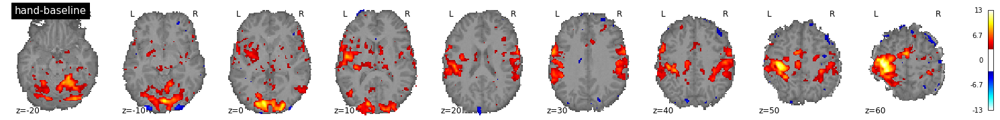

 Done working on subject: sub-14
  Contrast  4 out of 6: mouth-baseline


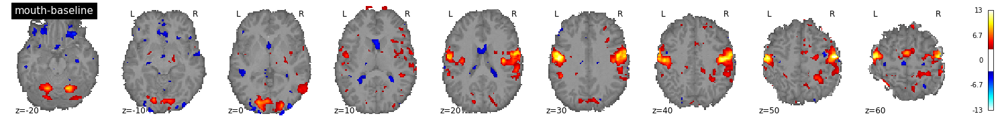

 Done working on subject: sub-14
  Contrast  5 out of 6: hand-mouth


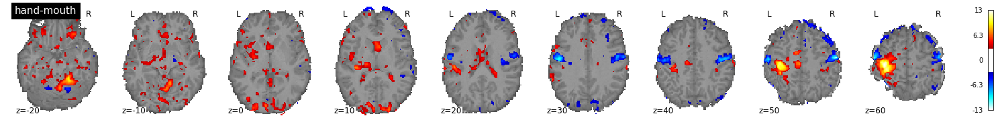

 Done working on subject: sub-14
  Contrast  6 out of 6: mouth-hand


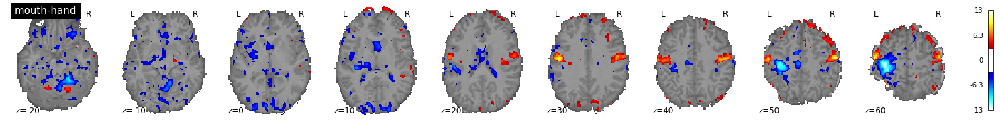

 Done working on subject: sub-14
 Working on subject: sub-15
  Contrast  1 out of 6: action-baseline


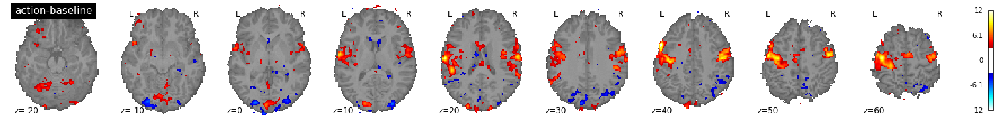

 Done working on subject: sub-15
  Contrast  2 out of 6: motion-baseline


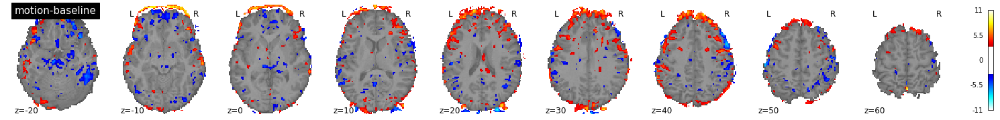

 Done working on subject: sub-15
  Contrast  3 out of 6: hand-baseline


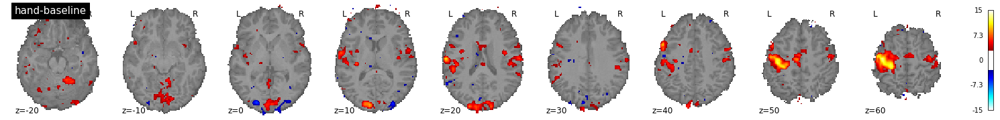

 Done working on subject: sub-15
  Contrast  4 out of 6: mouth-baseline


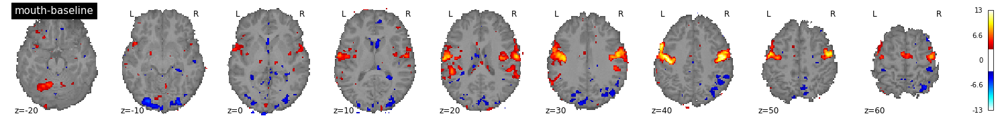

 Done working on subject: sub-15
  Contrast  5 out of 6: hand-mouth


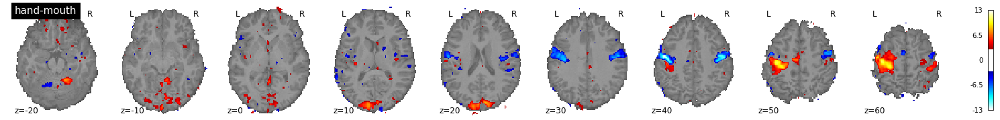

 Done working on subject: sub-15
  Contrast  6 out of 6: mouth-hand


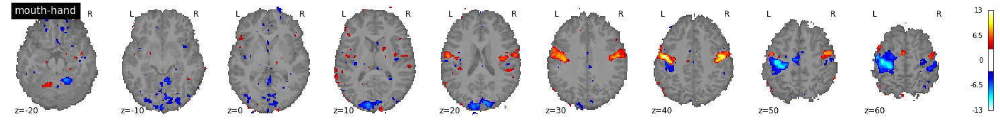

 Done working on subject: sub-15
 Working on subject: sub-16
  Contrast  1 out of 6: action-baseline


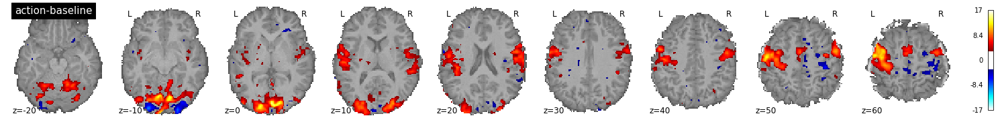

 Done working on subject: sub-16
  Contrast  2 out of 6: motion-baseline


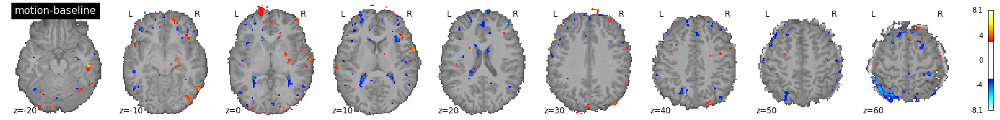

 Done working on subject: sub-16
  Contrast  3 out of 6: hand-baseline


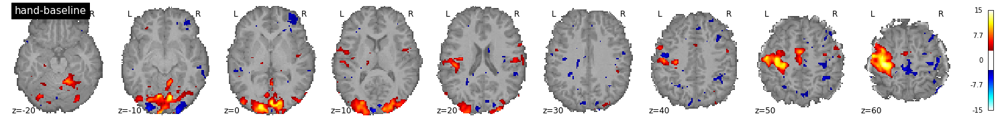

 Done working on subject: sub-16
  Contrast  4 out of 6: mouth-baseline


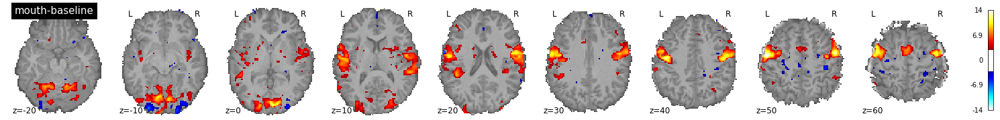

 Done working on subject: sub-16
  Contrast  5 out of 6: hand-mouth


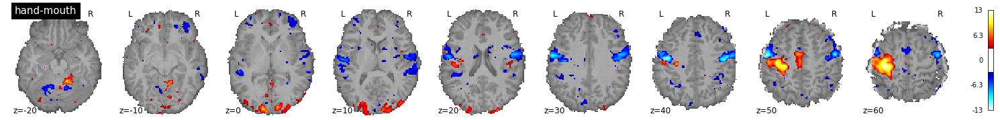

 Done working on subject: sub-16
  Contrast  6 out of 6: mouth-hand


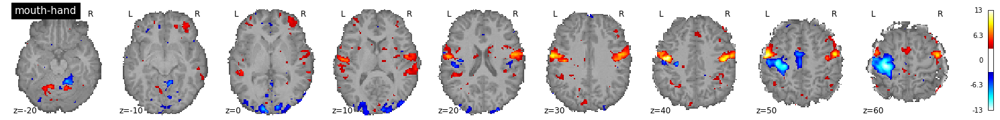

 Done working on subject: sub-16
 Working on subject: sub-17
  Contrast  1 out of 6: action-baseline


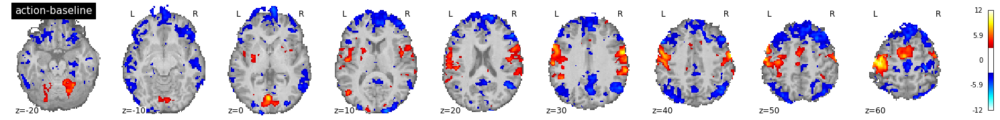

 Done working on subject: sub-17
  Contrast  2 out of 6: motion-baseline


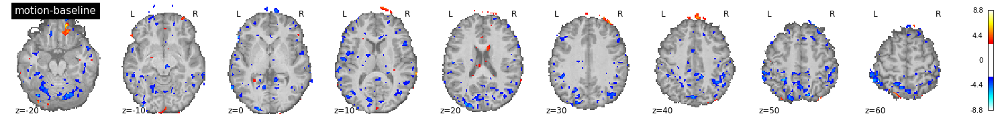

 Done working on subject: sub-17
  Contrast  3 out of 6: hand-baseline


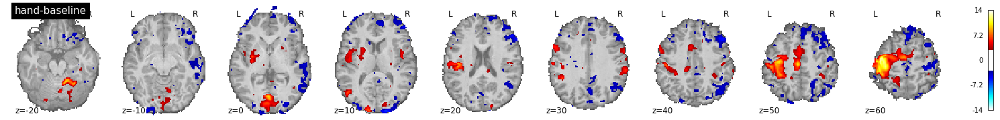

 Done working on subject: sub-17
  Contrast  4 out of 6: mouth-baseline


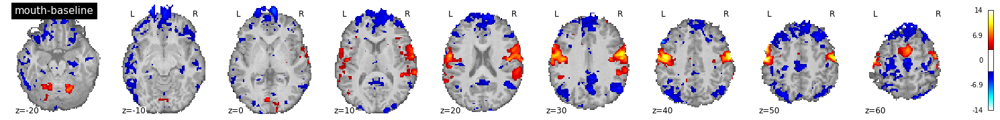

 Done working on subject: sub-17
  Contrast  5 out of 6: hand-mouth


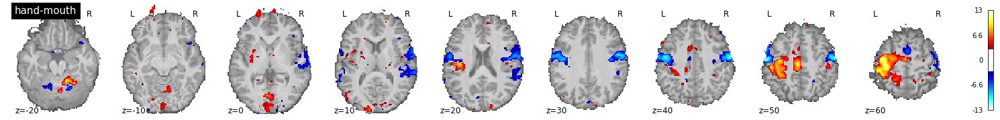

 Done working on subject: sub-17
  Contrast  6 out of 6: mouth-hand


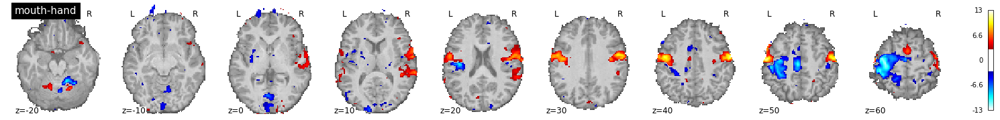

 Done working on subject: sub-17
 Working on subject: sub-18
  Contrast  1 out of 6: action-baseline


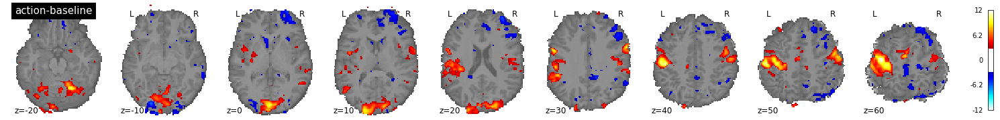

 Done working on subject: sub-18
  Contrast  2 out of 6: motion-baseline


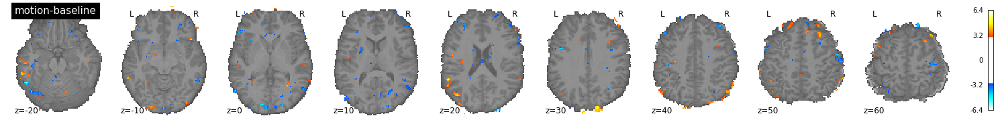

 Done working on subject: sub-18
  Contrast  3 out of 6: hand-baseline


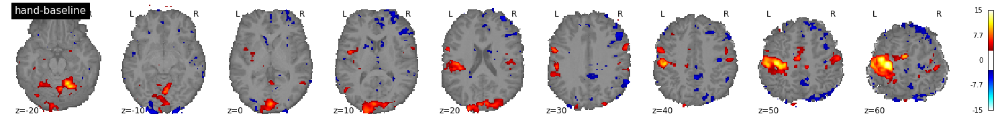

 Done working on subject: sub-18
  Contrast  4 out of 6: mouth-baseline


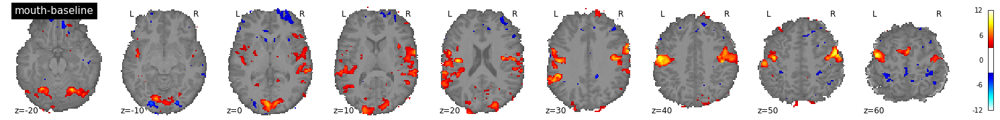

 Done working on subject: sub-18
  Contrast  5 out of 6: hand-mouth


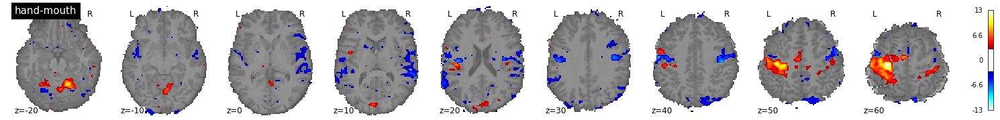

 Done working on subject: sub-18
  Contrast  6 out of 6: mouth-hand


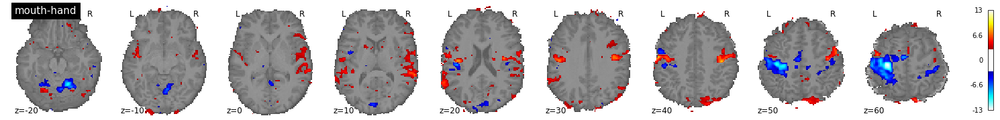

 Done working on subject: sub-18
 Working on subject: sub-19
  Contrast  1 out of 6: action-baseline


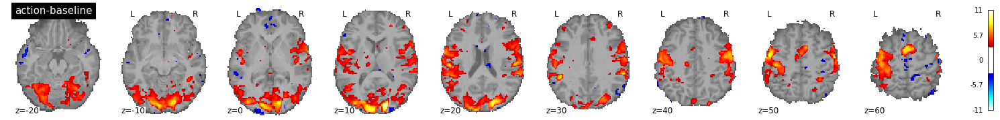

 Done working on subject: sub-19
  Contrast  2 out of 6: motion-baseline


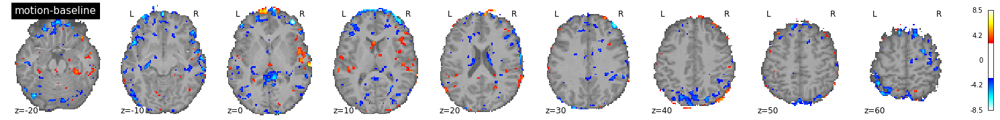

 Done working on subject: sub-19
  Contrast  3 out of 6: hand-baseline


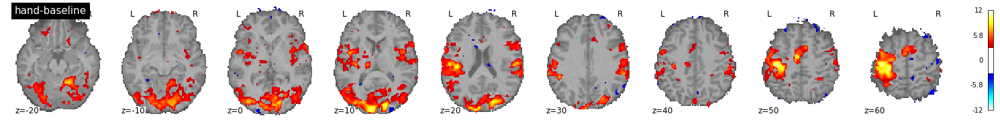

 Done working on subject: sub-19
  Contrast  4 out of 6: mouth-baseline


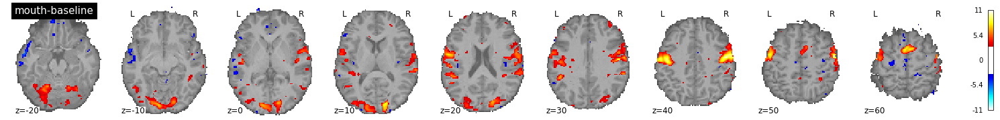

 Done working on subject: sub-19
  Contrast  5 out of 6: hand-mouth


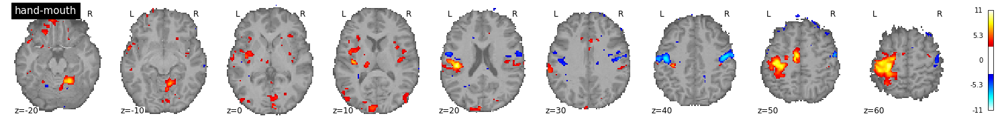

 Done working on subject: sub-19
  Contrast  6 out of 6: mouth-hand


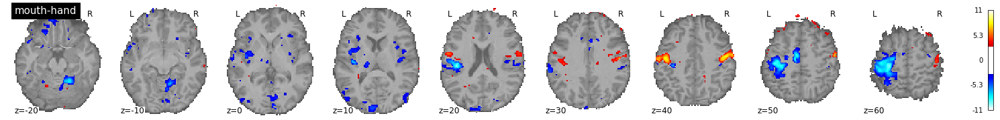

 Done working on subject: sub-19
 Working on subject: sub-20
  Contrast  1 out of 6: action-baseline


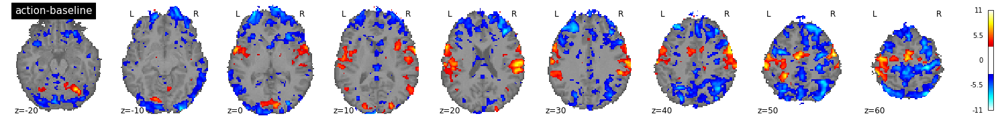

 Done working on subject: sub-20
  Contrast  2 out of 6: motion-baseline


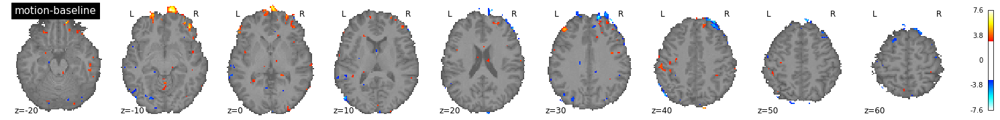

 Done working on subject: sub-20
  Contrast  3 out of 6: hand-baseline


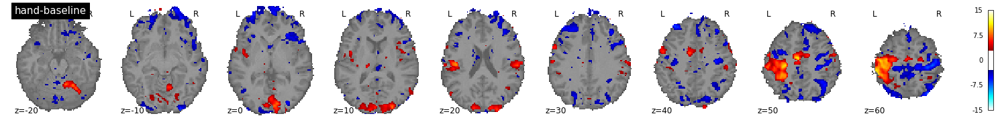

 Done working on subject: sub-20
  Contrast  4 out of 6: mouth-baseline


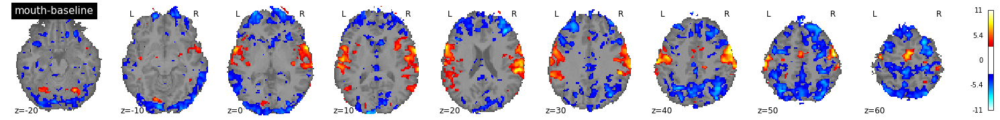

 Done working on subject: sub-20
  Contrast  5 out of 6: hand-mouth


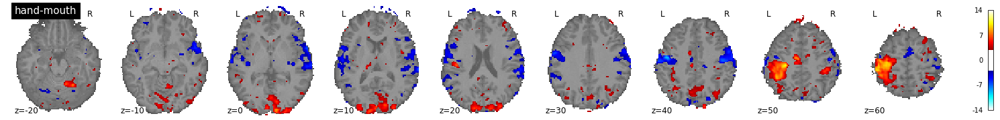

 Done working on subject: sub-20
  Contrast  6 out of 6: mouth-hand


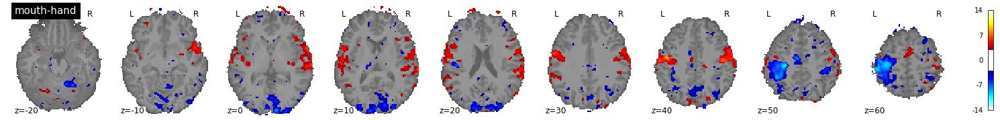

 Done working on subject: sub-20
 Working on subject: sub-21
  Contrast  1 out of 6: action-baseline


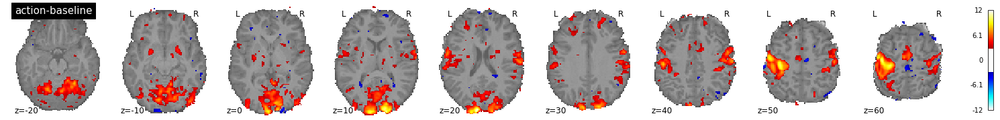

 Done working on subject: sub-21
  Contrast  2 out of 6: motion-baseline


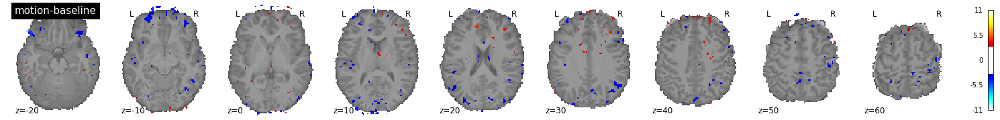

 Done working on subject: sub-21
  Contrast  3 out of 6: hand-baseline


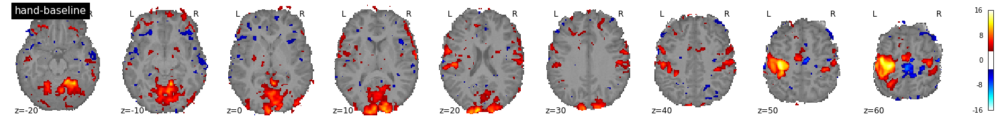

 Done working on subject: sub-21
  Contrast  4 out of 6: mouth-baseline


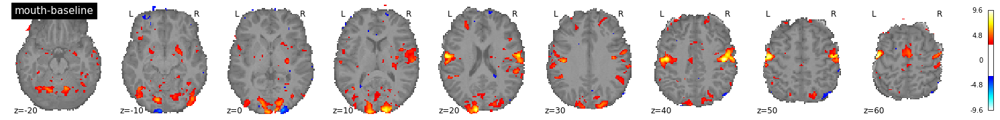

 Done working on subject: sub-21
  Contrast  5 out of 6: hand-mouth


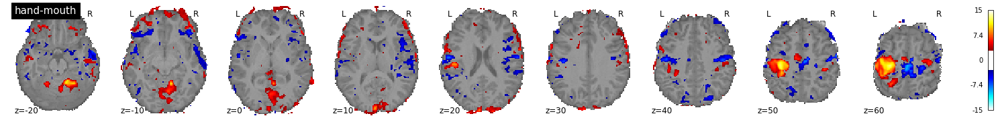

 Done working on subject: sub-21
  Contrast  6 out of 6: mouth-hand


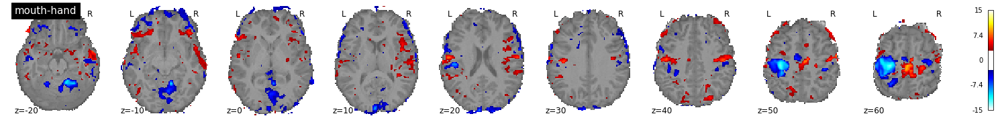

 Done working on subject: sub-21
 Working on subject: sub-22
  Contrast  1 out of 6: action-baseline


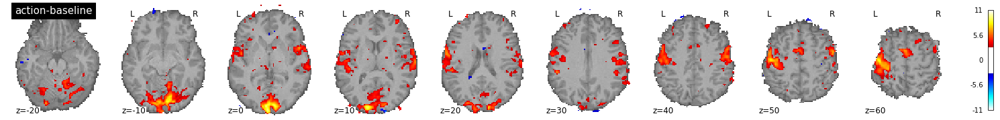

 Done working on subject: sub-22
  Contrast  2 out of 6: motion-baseline


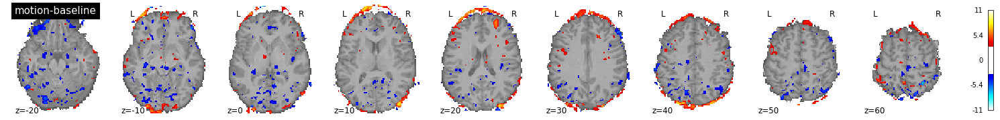

 Done working on subject: sub-22
  Contrast  3 out of 6: hand-baseline


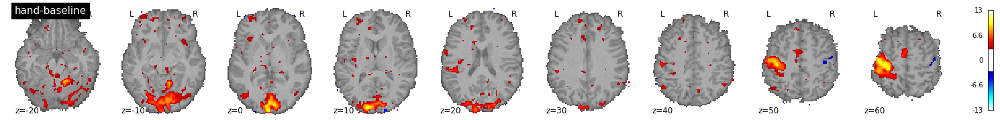

 Done working on subject: sub-22
  Contrast  4 out of 6: mouth-baseline


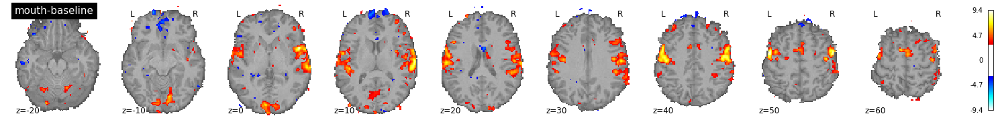

 Done working on subject: sub-22
  Contrast  5 out of 6: hand-mouth


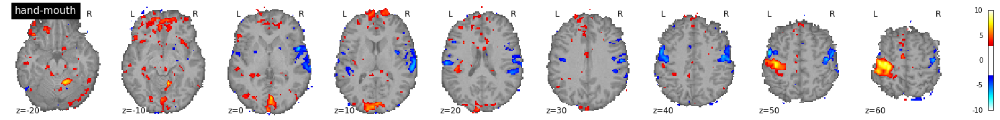

 Done working on subject: sub-22
  Contrast  6 out of 6: mouth-hand


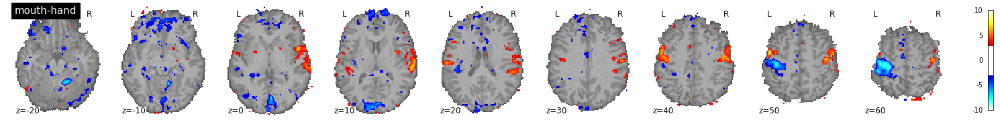

 Done working on subject: sub-22
 Working on subject: sub-23
  Contrast  1 out of 6: action-baseline


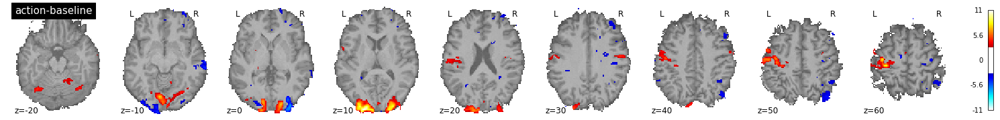

 Done working on subject: sub-23
  Contrast  2 out of 6: motion-baseline


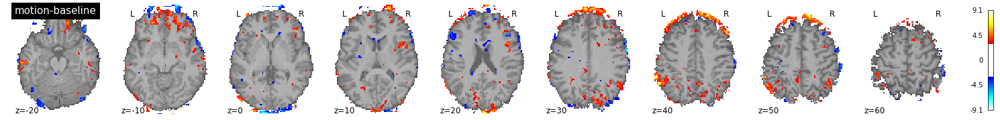

 Done working on subject: sub-23
  Contrast  3 out of 6: hand-baseline


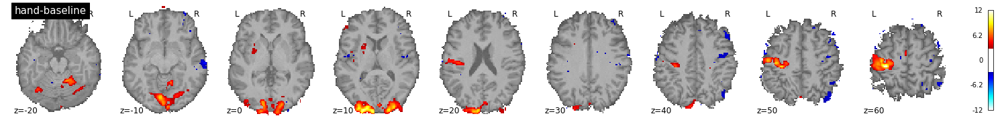

 Done working on subject: sub-23
  Contrast  4 out of 6: mouth-baseline


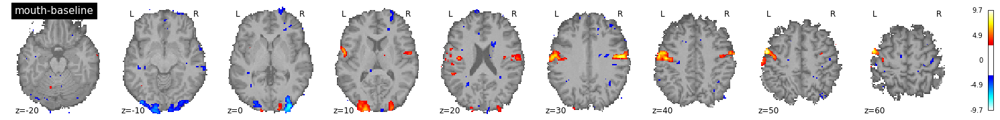

 Done working on subject: sub-23
  Contrast  5 out of 6: hand-mouth


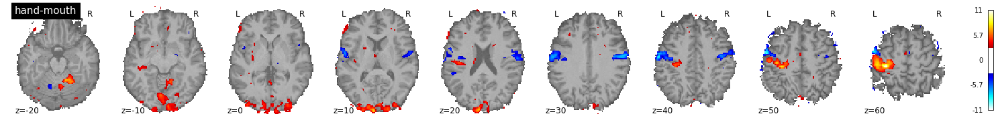

 Done working on subject: sub-23
  Contrast  6 out of 6: mouth-hand


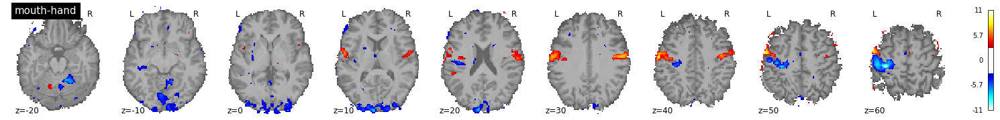

 Done working on subject: sub-23
 Working on subject: sub-24
  Contrast  1 out of 6: action-baseline


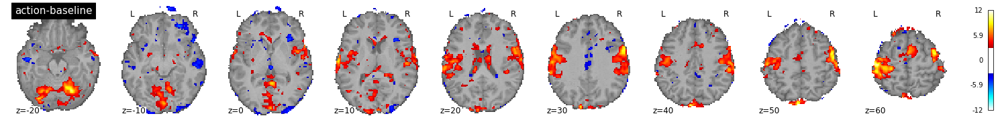

 Done working on subject: sub-24
  Contrast  2 out of 6: motion-baseline


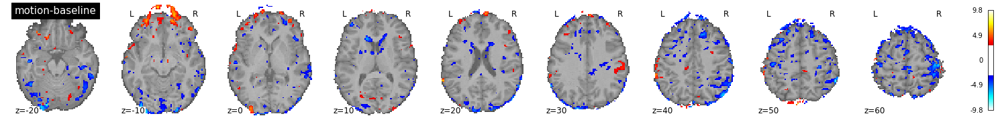

 Done working on subject: sub-24
  Contrast  3 out of 6: hand-baseline


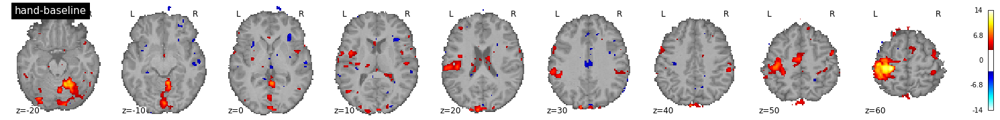

 Done working on subject: sub-24
  Contrast  4 out of 6: mouth-baseline


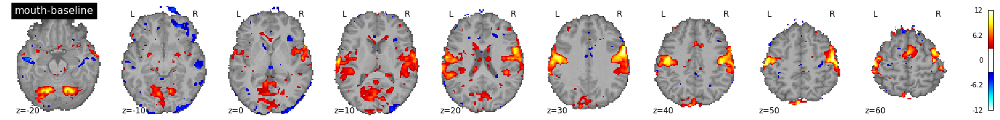

 Done working on subject: sub-24
  Contrast  5 out of 6: hand-mouth


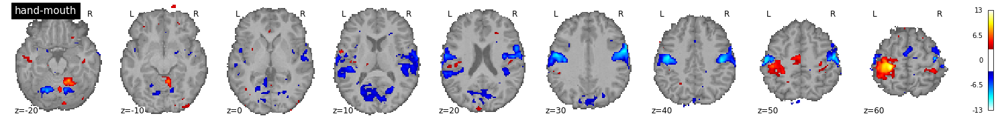

 Done working on subject: sub-24
  Contrast  6 out of 6: mouth-hand


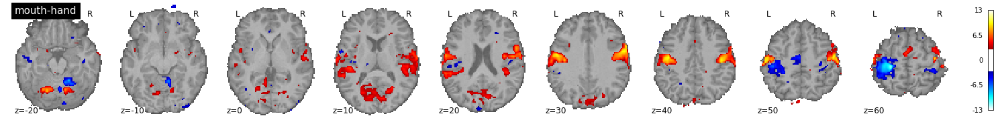

 Done working on subject: sub-24
 Working on subject: sub-25
  Contrast  1 out of 6: action-baseline


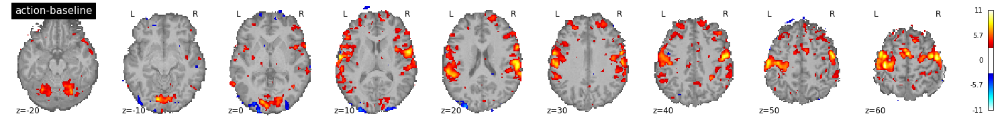

 Done working on subject: sub-25
  Contrast  2 out of 6: motion-baseline


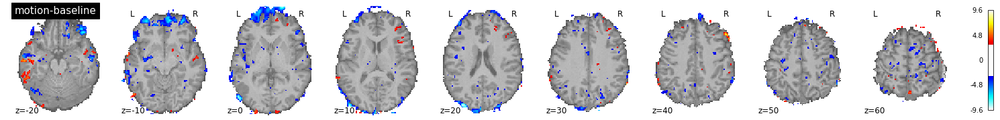

 Done working on subject: sub-25
  Contrast  3 out of 6: hand-baseline


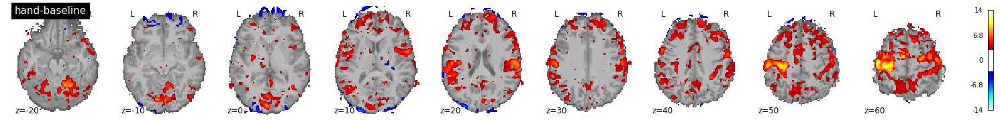

 Done working on subject: sub-25
  Contrast  4 out of 6: mouth-baseline


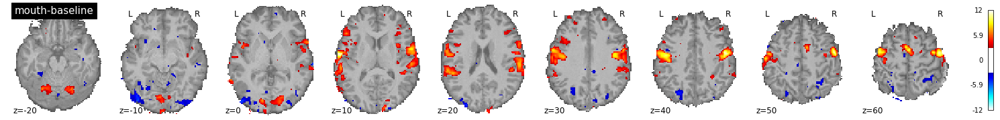

 Done working on subject: sub-25
  Contrast  5 out of 6: hand-mouth


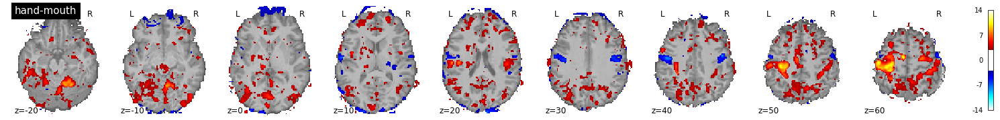

 Done working on subject: sub-25
  Contrast  6 out of 6: mouth-hand


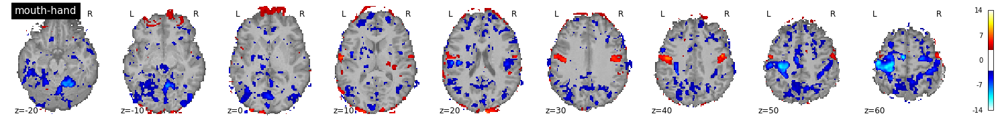

 Done working on subject: sub-25
 Working on subject: sub-26
  Contrast  1 out of 6: action-baseline


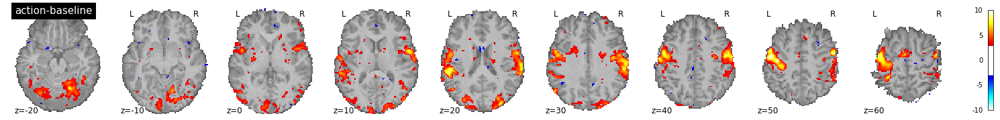

 Done working on subject: sub-26
  Contrast  2 out of 6: motion-baseline


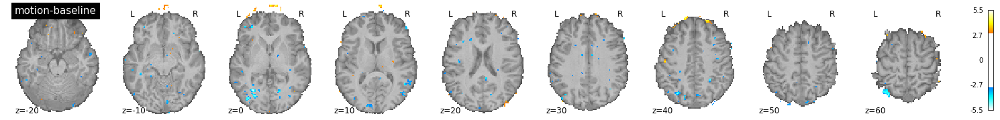

 Done working on subject: sub-26
  Contrast  3 out of 6: hand-baseline


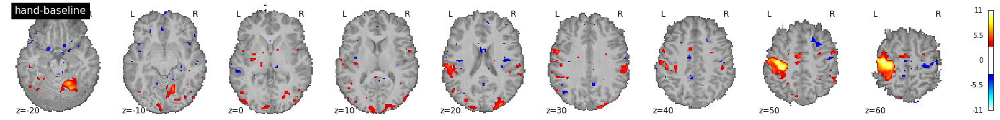

 Done working on subject: sub-26
  Contrast  4 out of 6: mouth-baseline


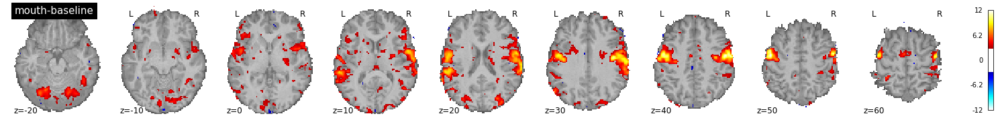

 Done working on subject: sub-26
  Contrast  5 out of 6: hand-mouth


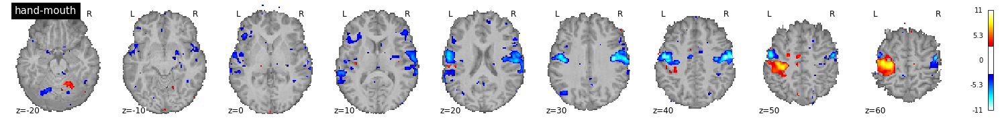

 Done working on subject: sub-26
  Contrast  6 out of 6: mouth-hand


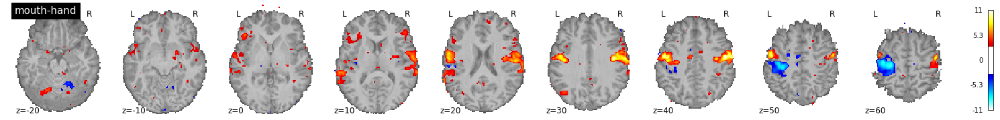

 Done working on subject: sub-26
 Working on subject: sub-27
  Contrast  1 out of 6: action-baseline


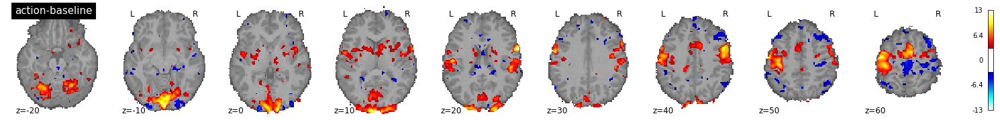

 Done working on subject: sub-27
  Contrast  2 out of 6: motion-baseline


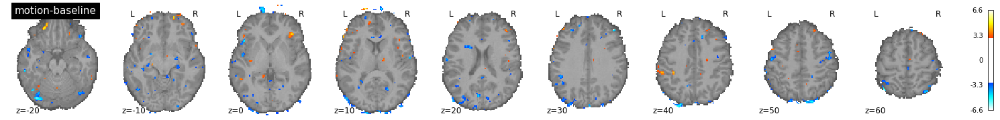

 Done working on subject: sub-27
  Contrast  3 out of 6: hand-baseline


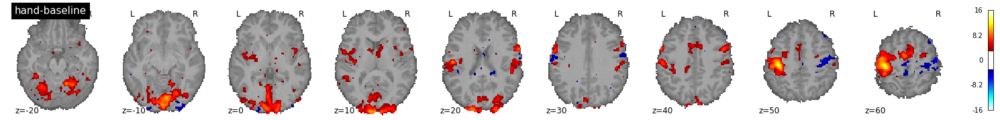

 Done working on subject: sub-27
  Contrast  4 out of 6: mouth-baseline


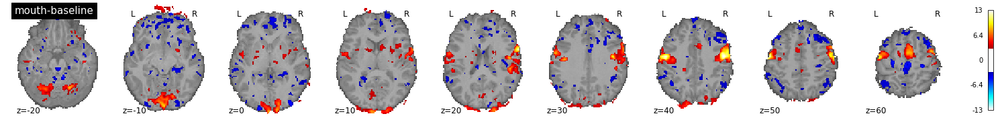

 Done working on subject: sub-27
  Contrast  5 out of 6: hand-mouth


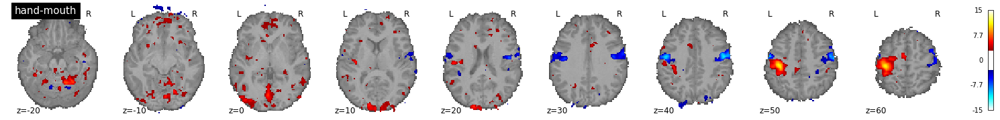

 Done working on subject: sub-27
  Contrast  6 out of 6: mouth-hand


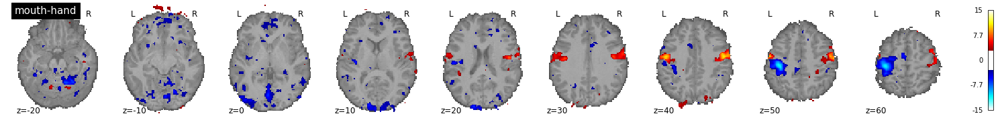

 Done working on subject: sub-27
 Working on subject: sub-28
  Contrast  1 out of 6: action-baseline


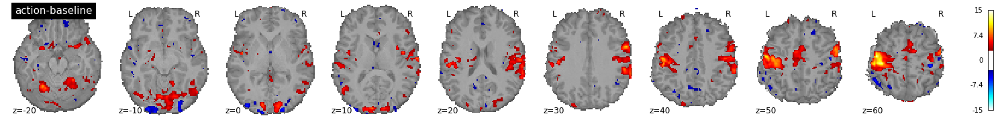

 Done working on subject: sub-28
  Contrast  2 out of 6: motion-baseline


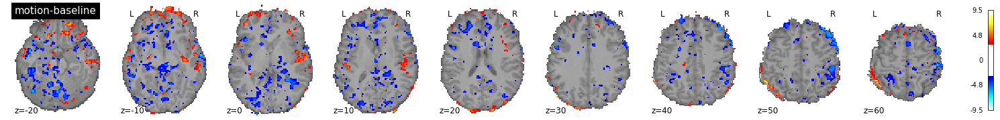

 Done working on subject: sub-28
  Contrast  3 out of 6: hand-baseline


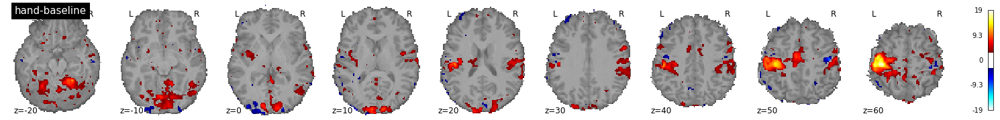

 Done working on subject: sub-28
  Contrast  4 out of 6: mouth-baseline


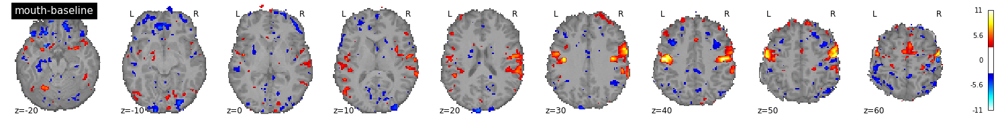

 Done working on subject: sub-28
  Contrast  5 out of 6: hand-mouth


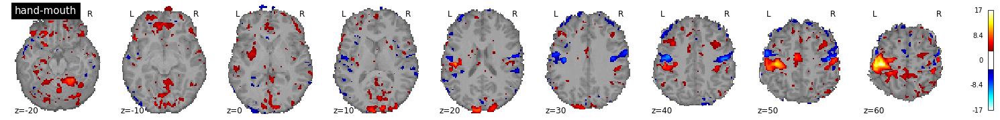

 Done working on subject: sub-28
  Contrast  6 out of 6: mouth-hand


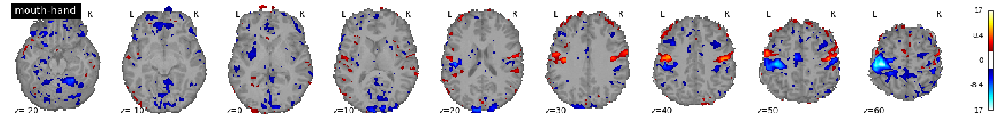

 Done working on subject: sub-28
 Working on subject: sub-29
  Contrast  1 out of 6: action-baseline


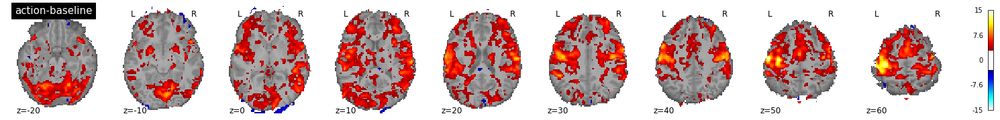

 Done working on subject: sub-29
  Contrast  2 out of 6: motion-baseline


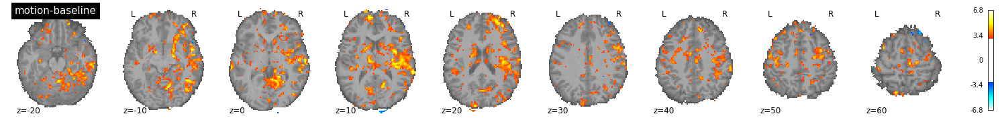

 Done working on subject: sub-29
  Contrast  3 out of 6: hand-baseline


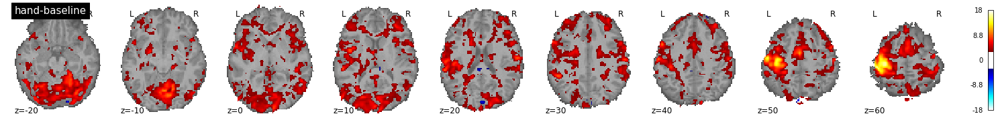

 Done working on subject: sub-29
  Contrast  4 out of 6: mouth-baseline


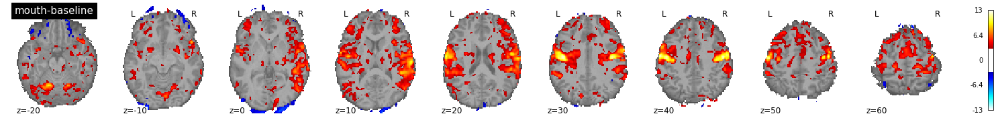

 Done working on subject: sub-29
  Contrast  5 out of 6: hand-mouth


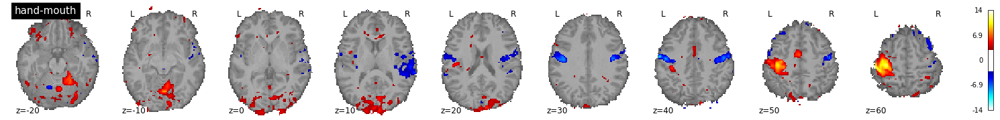

 Done working on subject: sub-29
  Contrast  6 out of 6: mouth-hand


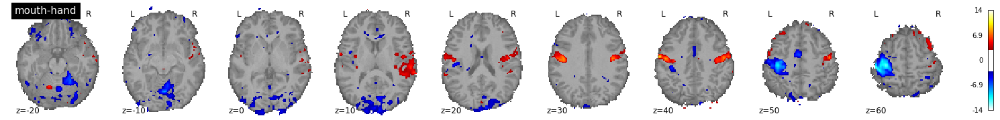

 Done working on subject: sub-29
 Working on subject: sub-30
  Contrast  1 out of 6: action-baseline


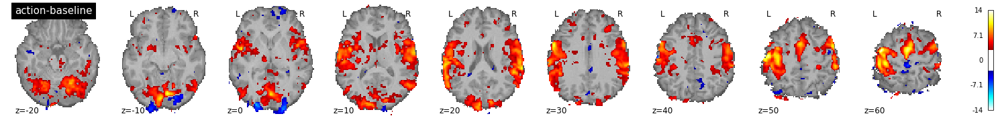

 Done working on subject: sub-30
  Contrast  2 out of 6: motion-baseline


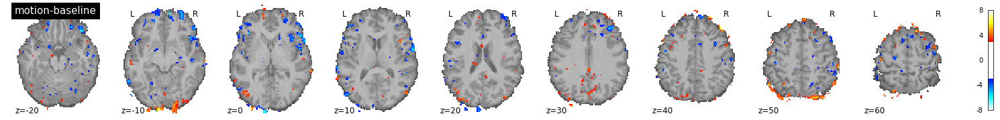

 Done working on subject: sub-30
  Contrast  3 out of 6: hand-baseline


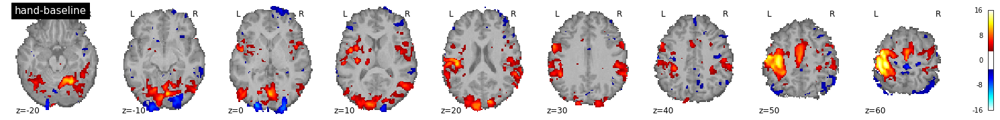

 Done working on subject: sub-30
  Contrast  4 out of 6: mouth-baseline


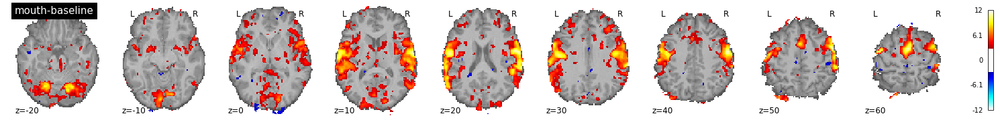

 Done working on subject: sub-30
  Contrast  5 out of 6: hand-mouth


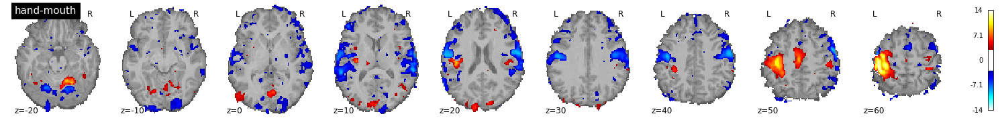

 Done working on subject: sub-30
  Contrast  6 out of 6: mouth-hand


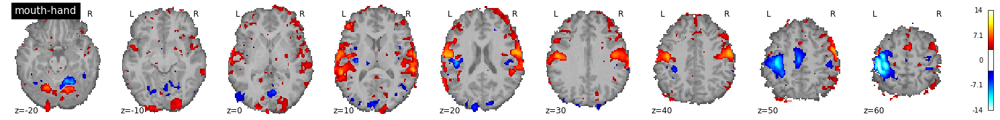

 Done working on subject: sub-30
 Working on subject: sub-31
  Contrast  1 out of 6: action-baseline


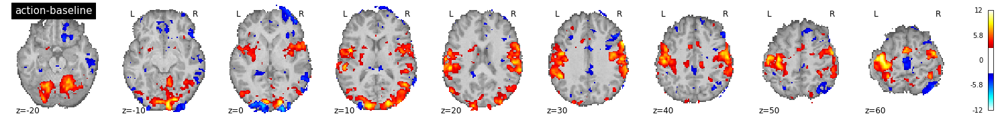

 Done working on subject: sub-31
  Contrast  2 out of 6: motion-baseline


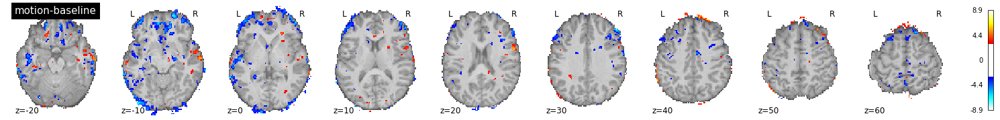

 Done working on subject: sub-31
  Contrast  3 out of 6: hand-baseline


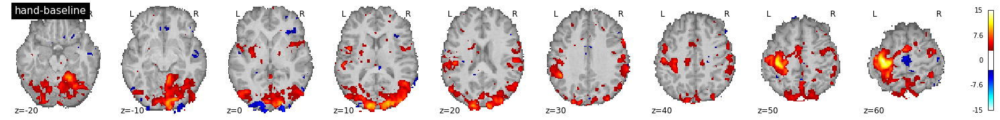

 Done working on subject: sub-31
  Contrast  4 out of 6: mouth-baseline


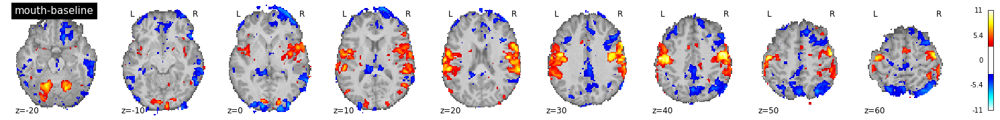

 Done working on subject: sub-31
  Contrast  5 out of 6: hand-mouth


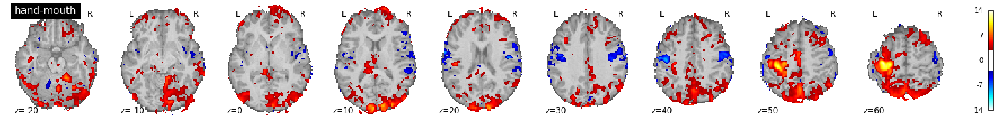

 Done working on subject: sub-31
  Contrast  6 out of 6: mouth-hand


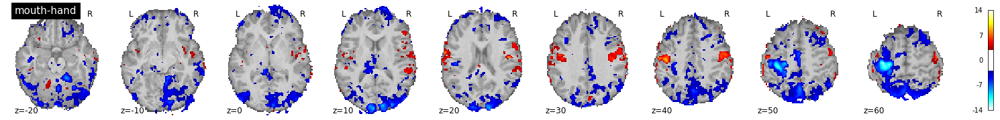

 Done working on subject: sub-31
 Working on subject: sub-32
  Contrast  1 out of 6: action-baseline


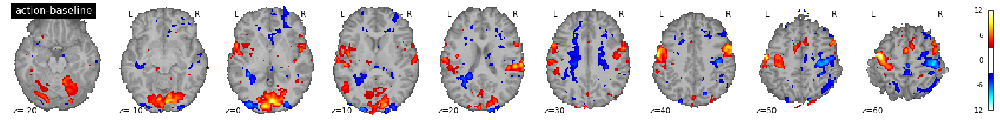

 Done working on subject: sub-32
  Contrast  2 out of 6: motion-baseline


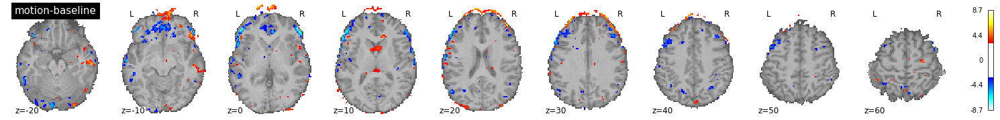

 Done working on subject: sub-32
  Contrast  3 out of 6: hand-baseline


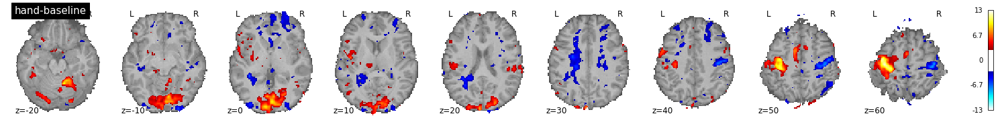

 Done working on subject: sub-32
  Contrast  4 out of 6: mouth-baseline


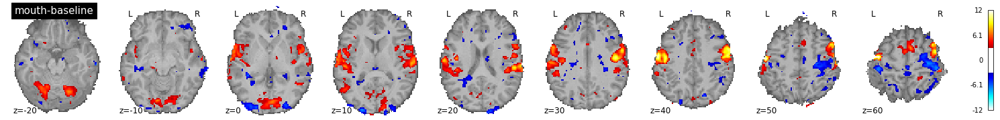

 Done working on subject: sub-32
  Contrast  5 out of 6: hand-mouth


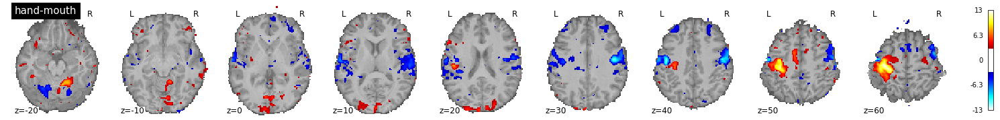

 Done working on subject: sub-32
  Contrast  6 out of 6: mouth-hand


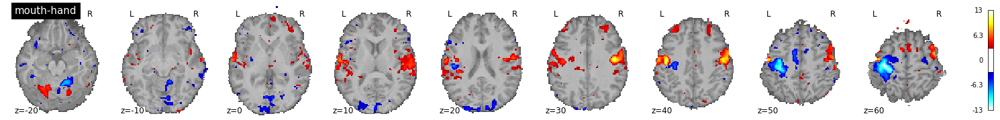

 Done working on subject: sub-32
 Working on subject: sub-33
  Contrast  1 out of 6: action-baseline


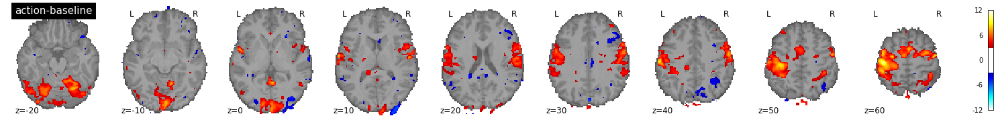

 Done working on subject: sub-33
  Contrast  2 out of 6: motion-baseline


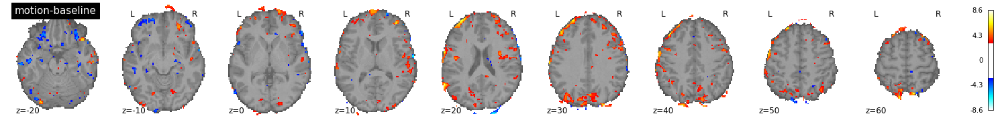

 Done working on subject: sub-33
  Contrast  3 out of 6: hand-baseline


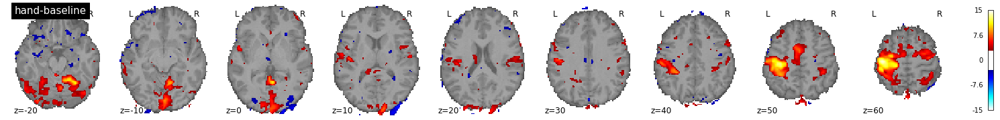

 Done working on subject: sub-33
  Contrast  4 out of 6: mouth-baseline


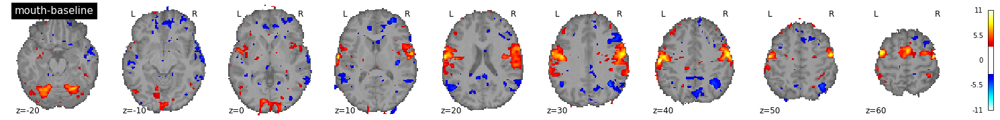

 Done working on subject: sub-33
  Contrast  5 out of 6: hand-mouth


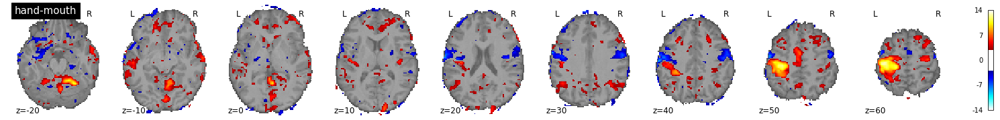

 Done working on subject: sub-33
  Contrast  6 out of 6: mouth-hand


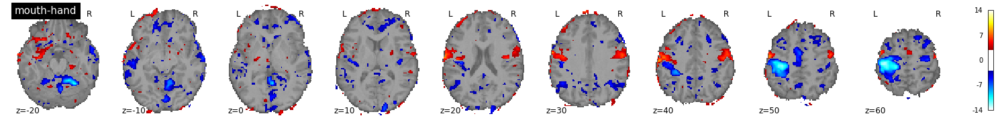

 Done working on subject: sub-33
 Working on subject: sub-34
  Contrast  1 out of 6: action-baseline


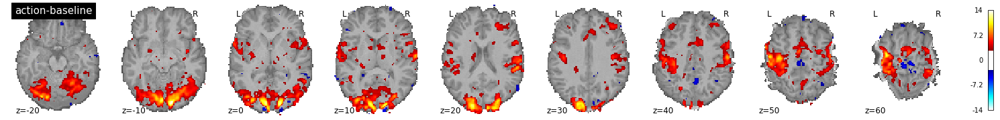

 Done working on subject: sub-34
  Contrast  2 out of 6: motion-baseline


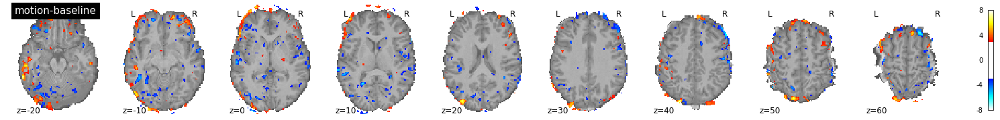

 Done working on subject: sub-34
  Contrast  3 out of 6: hand-baseline


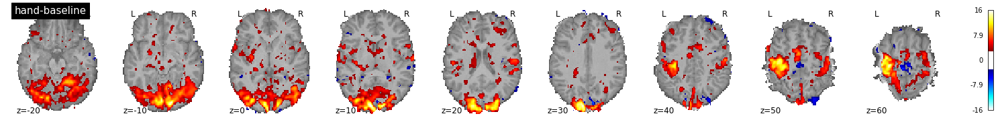

 Done working on subject: sub-34
  Contrast  4 out of 6: mouth-baseline


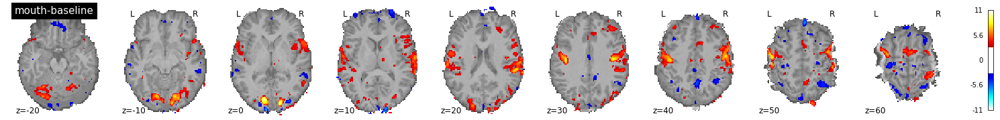

 Done working on subject: sub-34
  Contrast  5 out of 6: hand-mouth


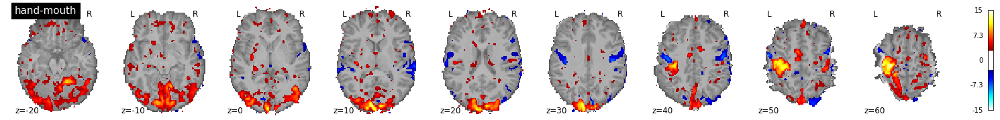

 Done working on subject: sub-34
  Contrast  6 out of 6: mouth-hand


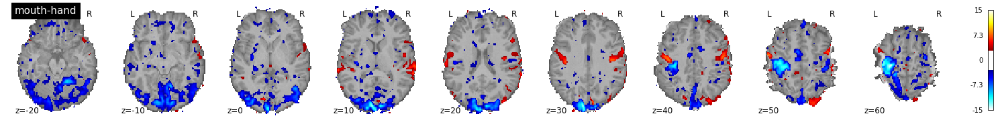

 Done working on subject: sub-34
 Working on subject: sub-35
  Contrast  1 out of 6: action-baseline


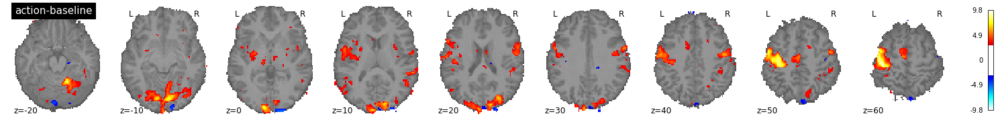

 Done working on subject: sub-35
  Contrast  2 out of 6: motion-baseline


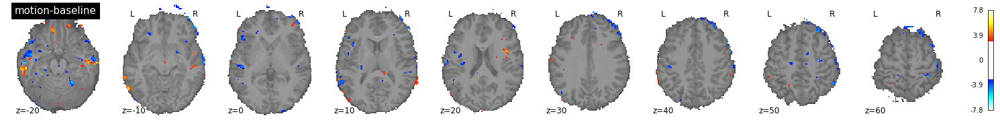

 Done working on subject: sub-35
  Contrast  3 out of 6: hand-baseline


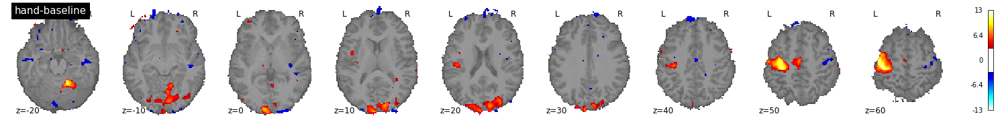

 Done working on subject: sub-35
  Contrast  4 out of 6: mouth-baseline


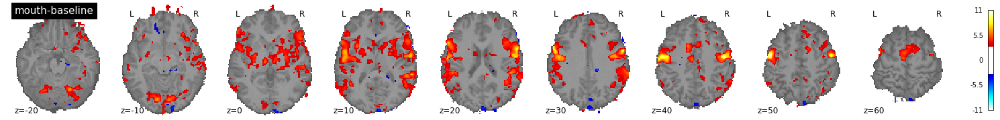

 Done working on subject: sub-35
  Contrast  5 out of 6: hand-mouth


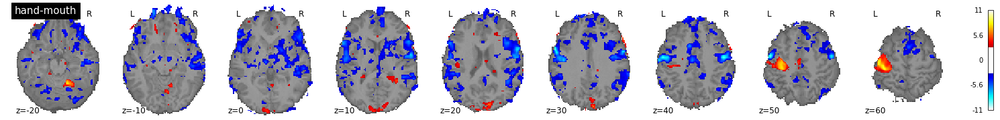

 Done working on subject: sub-35
  Contrast  6 out of 6: mouth-hand


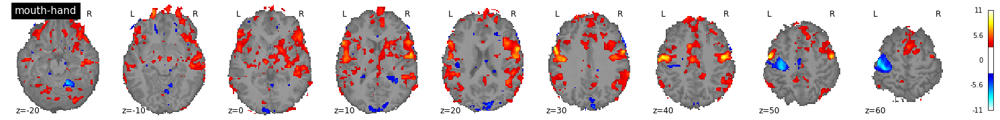

 Done working on subject: sub-35
 Working on subject: sub-36
  Contrast  1 out of 6: action-baseline


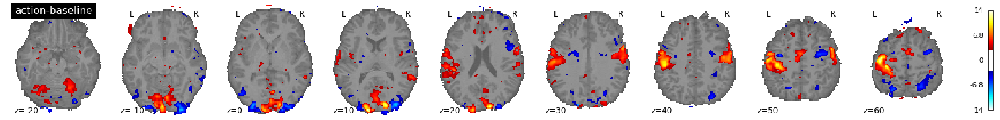

 Done working on subject: sub-36
  Contrast  2 out of 6: motion-baseline


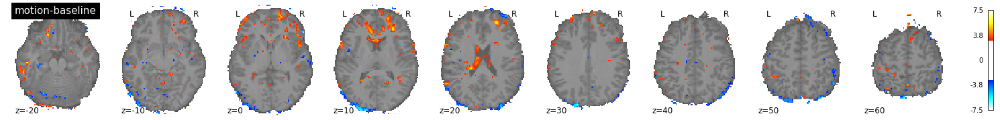

 Done working on subject: sub-36
  Contrast  3 out of 6: hand-baseline


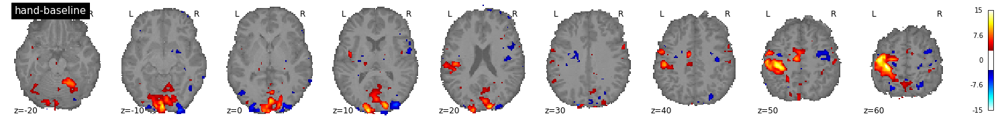

 Done working on subject: sub-36
  Contrast  4 out of 6: mouth-baseline


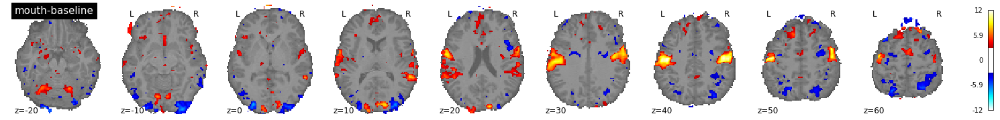

 Done working on subject: sub-36
  Contrast  5 out of 6: hand-mouth


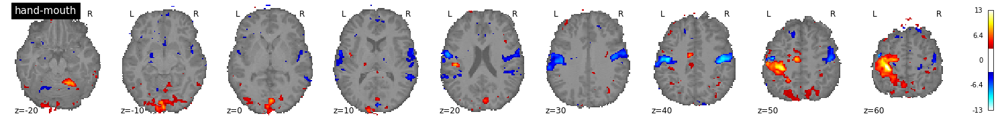

 Done working on subject: sub-36
  Contrast  6 out of 6: mouth-hand


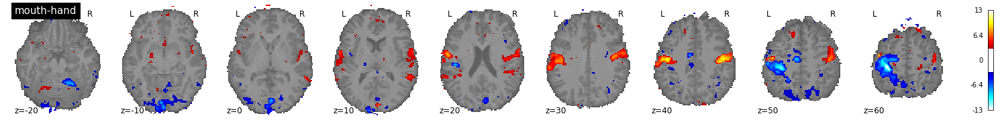

 Done working on subject: sub-36
 Working on subject: sub-37
  Contrast  1 out of 6: action-baseline


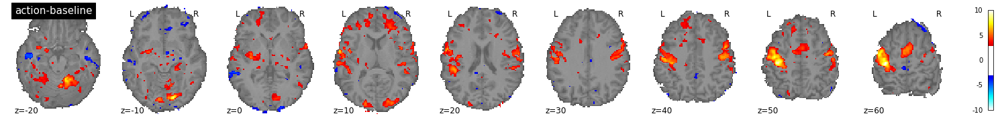

 Done working on subject: sub-37
  Contrast  2 out of 6: motion-baseline


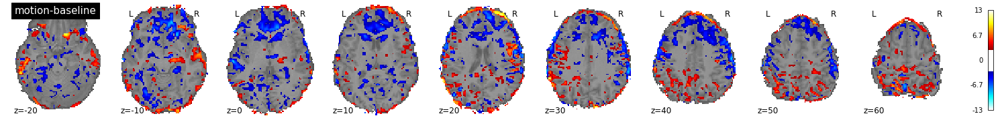

 Done working on subject: sub-37
  Contrast  3 out of 6: hand-baseline


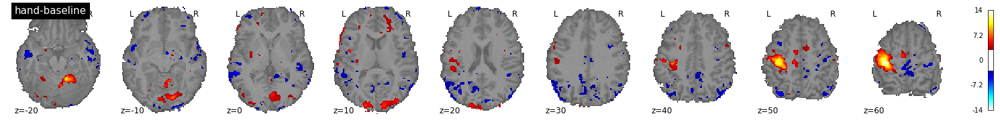

 Done working on subject: sub-37
  Contrast  4 out of 6: mouth-baseline


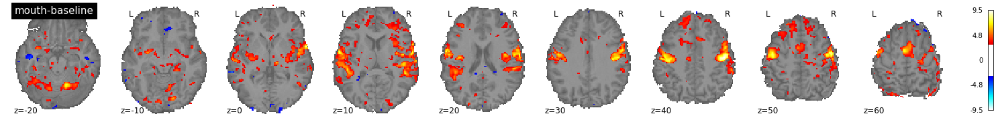

 Done working on subject: sub-37
  Contrast  5 out of 6: hand-mouth


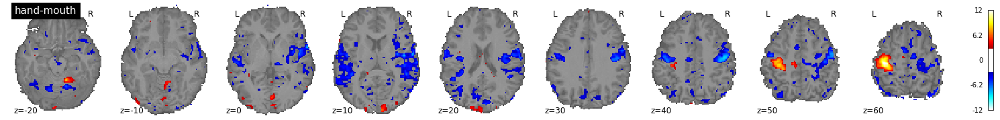

 Done working on subject: sub-37
  Contrast  6 out of 6: mouth-hand


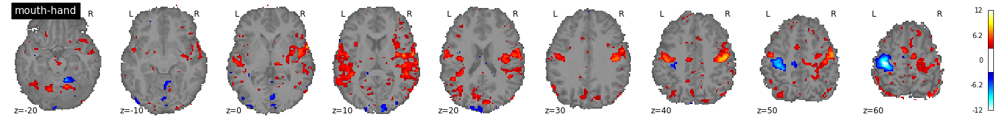

 Done working on subject: sub-37
 Working on subject: sub-38
  Contrast  1 out of 6: action-baseline


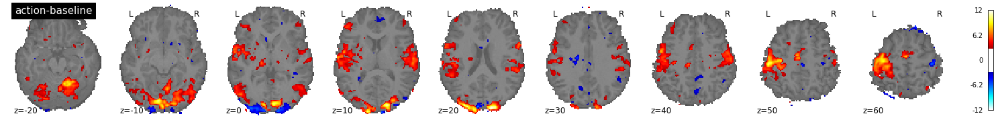

 Done working on subject: sub-38
  Contrast  2 out of 6: motion-baseline


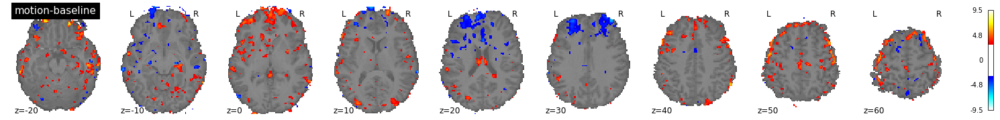

 Done working on subject: sub-38
  Contrast  3 out of 6: hand-baseline


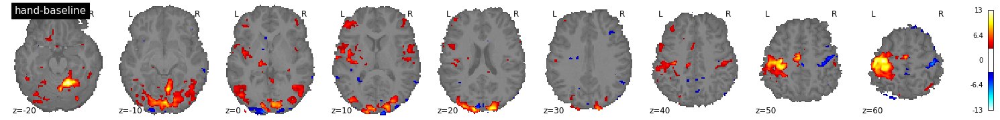

 Done working on subject: sub-38
  Contrast  4 out of 6: mouth-baseline


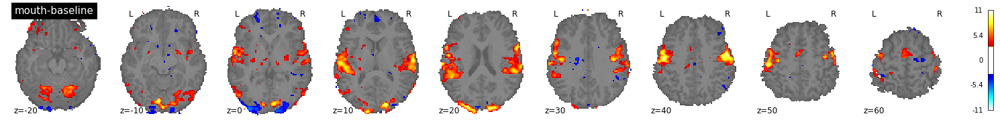

 Done working on subject: sub-38
  Contrast  5 out of 6: hand-mouth


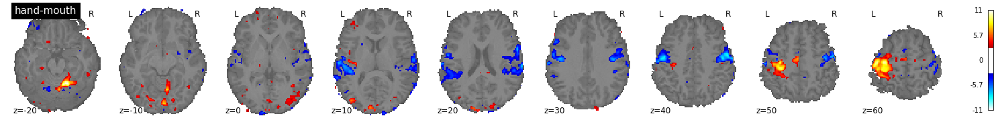

 Done working on subject: sub-38
  Contrast  6 out of 6: mouth-hand


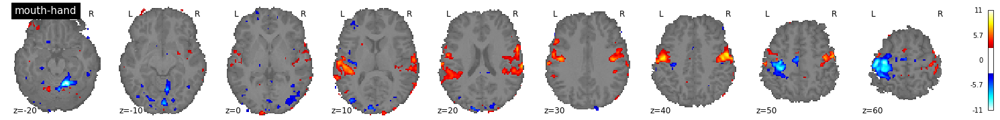

 Done working on subject: sub-38
 Working on subject: sub-39
  Contrast  1 out of 6: action-baseline


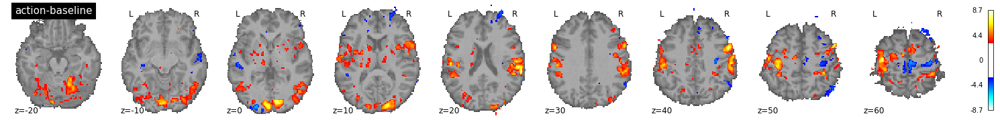

 Done working on subject: sub-39
  Contrast  2 out of 6: motion-baseline


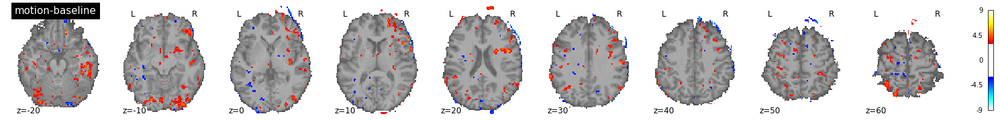

 Done working on subject: sub-39
  Contrast  3 out of 6: hand-baseline


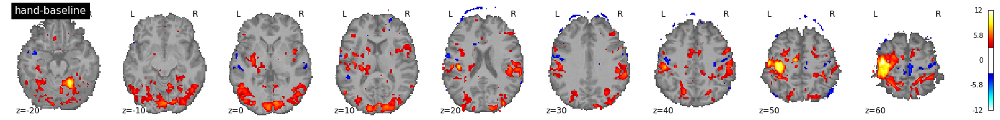

 Done working on subject: sub-39
  Contrast  4 out of 6: mouth-baseline


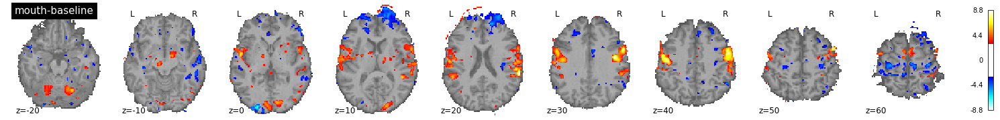

 Done working on subject: sub-39
  Contrast  5 out of 6: hand-mouth


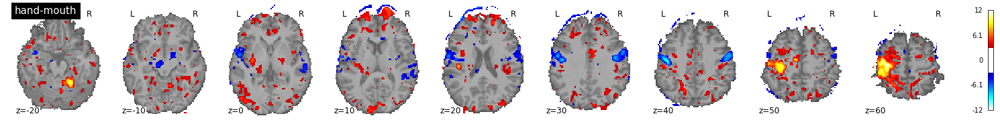

 Done working on subject: sub-39
  Contrast  6 out of 6: mouth-hand


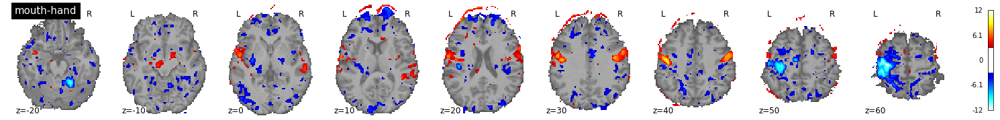

 Done working on subject: sub-39
 Working on subject: sub-40
  Contrast  1 out of 6: action-baseline


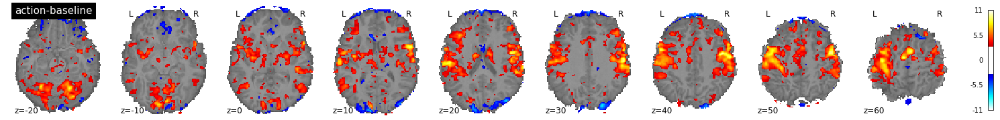

 Done working on subject: sub-40
  Contrast  2 out of 6: motion-baseline


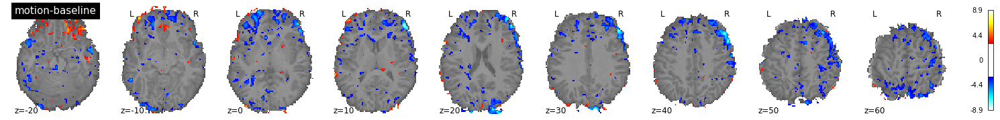

 Done working on subject: sub-40
  Contrast  3 out of 6: hand-baseline


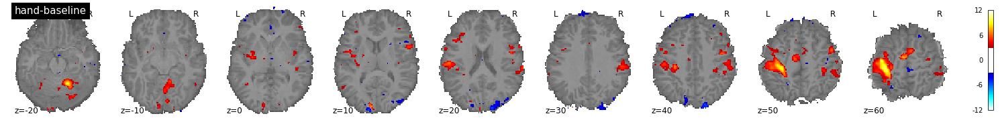

 Done working on subject: sub-40
  Contrast  4 out of 6: mouth-baseline


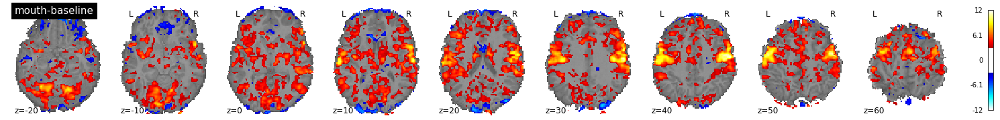

 Done working on subject: sub-40
  Contrast  5 out of 6: hand-mouth


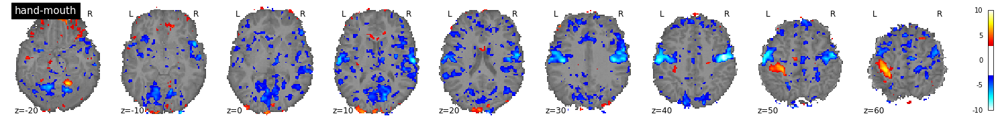

 Done working on subject: sub-40
  Contrast  6 out of 6: mouth-hand


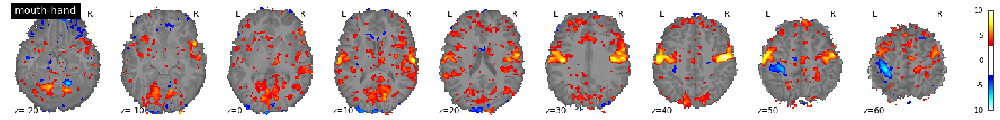

 Done working on subject: sub-40


In [22]:
for i, sbj in enumerate(sbj_list):
    print(f' Working on subject: {sbj}')
    for j, (contrast_id, contrast_val) in enumerate(contrasts.items()):
        print('  Contrast % 2i out of %i: %s' % (
            j + 1, len(contrasts), contrast_id))
        # Estimate the contasts. Note that the model implicitly computes a fixed
        # effect across the two sessions
        z_map = action_flm_dict.get(sbj).compute_contrast(
            contrast_val, output_type='z_score')
        
        # plot the contrasts 
        # the display is overlaid on the warped anatomical
        plotting.plot_stat_map(
            z_map, 
            bg_img=anat_dict.get(sbj), 
            threshold=3.0, 
            display_mode='z',
            cut_coords=range(-20, 70, 10), 
            black_bg=False, 
            title=contrast_id,
            symmetric_cbar=True)
        plotting.show()

        # create a folder to store the output files
        if not os.path.exists(action_first_level_dir / contrast_id):
            os.makedirs(action_first_level_dir / contrast_id)
        
        # write the resulting stat images to file
        z_image_path = f"{action_first_level_dir}/{contrast_id}/{sbj}_{contrast_id}_z_map.nii.gz"
        z_map.to_filename(z_image_path)
        
        print(f' Done working on subject: {sbj}')
        

### That was it! Now we can use these z-maps for the Second-level-Model!